# Technical note for *clone2vec* algorithm

Here we will provide detailed exploration of *clone2vec* algorithms based on different simulations.

In [2]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import sys

sys.path.append("/home/sergey/tools/scLiTr/")
import sclitr as sl

sc.set_figure_params(dpi=100, dpi_save=300)
sns.set_style("ticks")

import matplotlib

matplotlib.rcParams["pdf.fonttype"] = 42
matplotlib.rcParams["ps.fonttype"] = 42

In [620]:
data = pd.DataFrame({
    "Set 1":  [13, 13, 8, 14, 13, 3, 2, 1, 1, 3],
    "Set 2":  [13, 9, 12, 12, 1, 2, 0, 2, 2, 5],
    "Set 3":  [13, 13, 10, 11, 20, 1, 2, 5, 2, 5],
    "Set 4":  [17, 12, 11, 15, 14, 4, 0, 1, 0, 2],
    "Set 5":  [16, 11, 15, 15, 6, 4, 1, 5, 4, 0],
    "Set 6":  [1, 3, 1, 1, 5, 11, 10, 14, 17, 15],
    "Set 7":  [1, 0, 1, 1, 1, 10, 15, 16, 10, 9],
    "Set 8":  [0, 0, 3, 1, 5, 11, 16, 10, 13, 10],
    "Set 9":  [0, 1, 1, 2, 4, 17, 13, 10, 17, 12],
    "Set 10": [2, 5, 4, 1, 1, 10, 10, 8, 16, 12]
})

data.index = data.columns
data = data.T
data = sc.AnnData(data)

sc.pp.pca(data, zero_center=False, n_comps=3)

<Axes: >

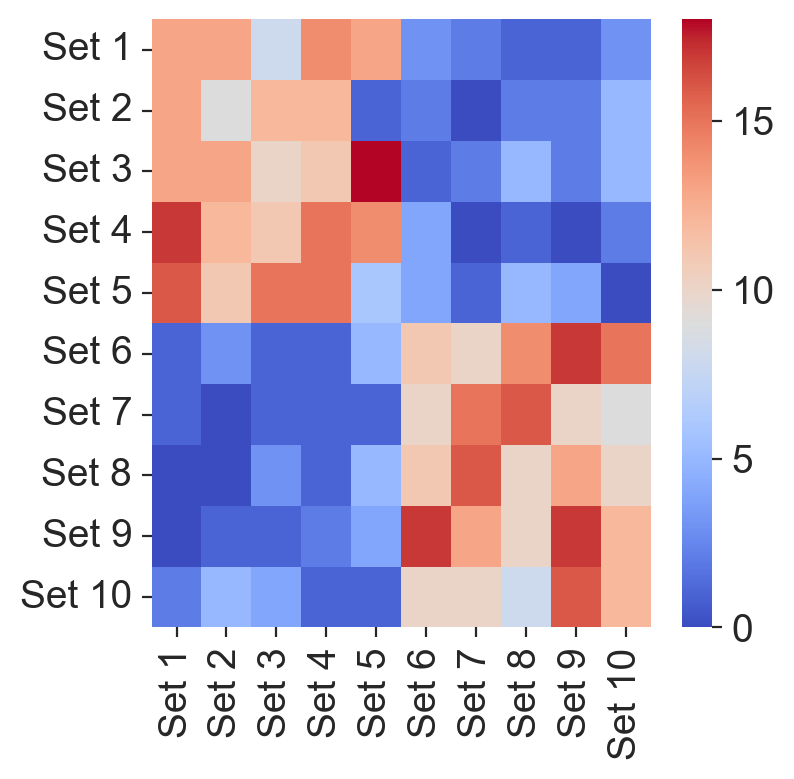

In [648]:
sns.heatmap(data.to_df(), cmap="coolwarm", vmax=18)

<Axes: >

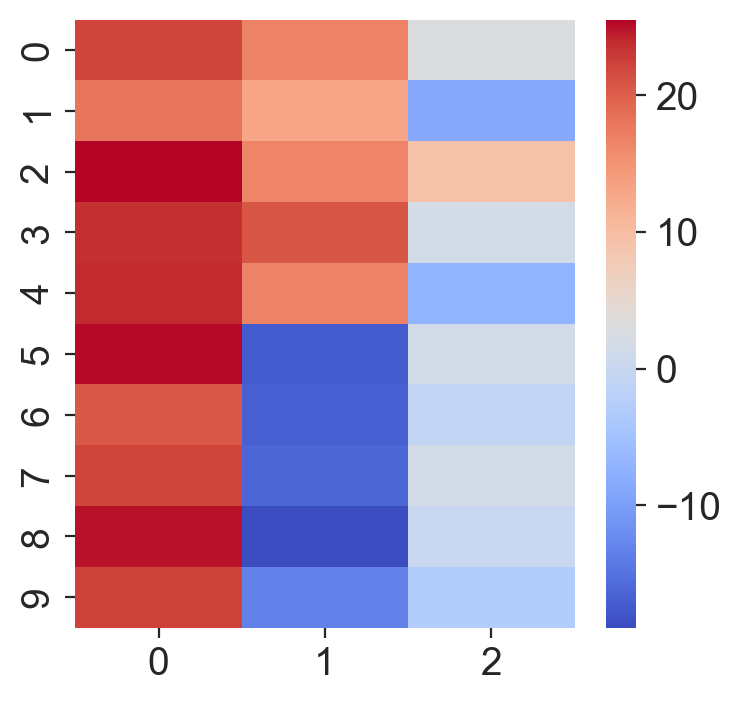

In [635]:
sns.heatmap(pd.DataFrame(data.obsm["X_pca"]), cmap="coolwarm")

<Axes: >

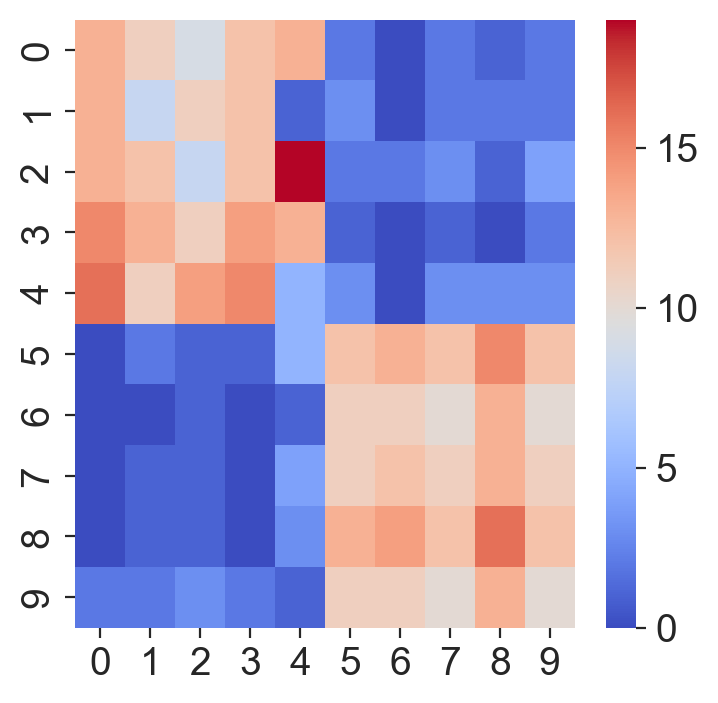

In [643]:
sns.heatmap(pd.DataFrame((data.obsm["X_pca"] @ data.varm["PCs"].T).astype(int)), cmap="coolwarm")

<Axes: >

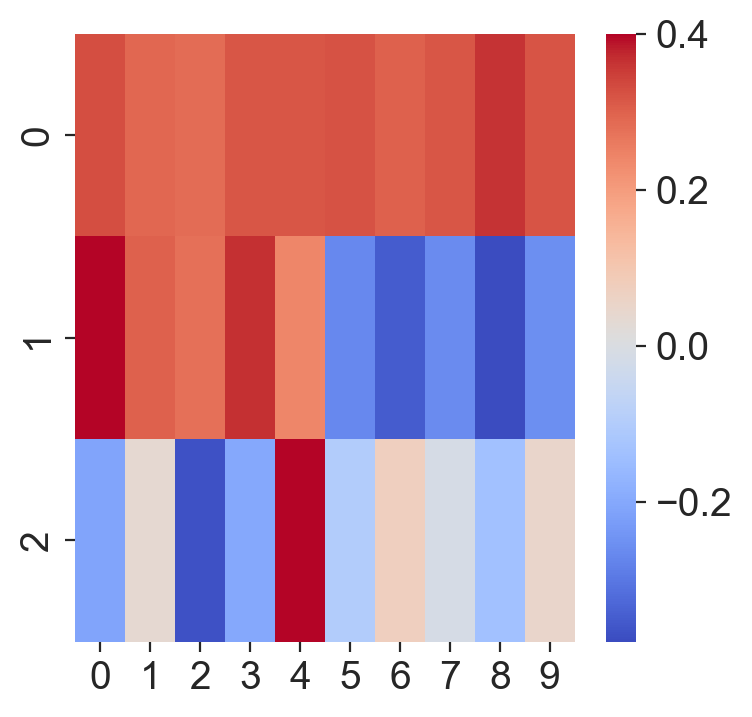

In [640]:
sns.heatmap(pd.DataFrame(data.varm["PCs"]).T, cmap="coolwarm", vmax=0.4)

## Continious behaviour

In [161]:
generate_coordinates = {
    "A": lambda x: np.array([
        np.random.normal(0, size=x),
        np.random.normal(0, size=x),
    ]).T,
    "B": lambda x: np.array([
        np.random.normal(10, size=x),
        np.random.normal(10, size=x),
    ]).T,
}

def create_clone(x, p):
    num_A = round(x * p)
    num_B = x - num_A
    return np.concatenate([
        generate_coordinates["A"](num_A),
        generate_coordinates["B"](num_B),
    ])

In [71]:
coordinates = []
labels = []
ps = []
clones_ground_truth = {}
cells_labels = []

clone_number = 0
for p in np.arange(0, 1, 0.1):
    for i in range(500):
        clone_name = f"clone_{clone_number}"
        clones_ground_truth[clone_name] = p
        clone_size = 10
        coordinates += list(create_clone(clone_size, p))
        labels += [clone_name] * clone_size
        ps += [p] * clone_size
        clone_number += 1
        cells_labels += (
            ["A"] * round(clone_size * p) +
            ["B"] * (clone_size - round(clone_size * p))
        )
        
coordinates = np.array(coordinates)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


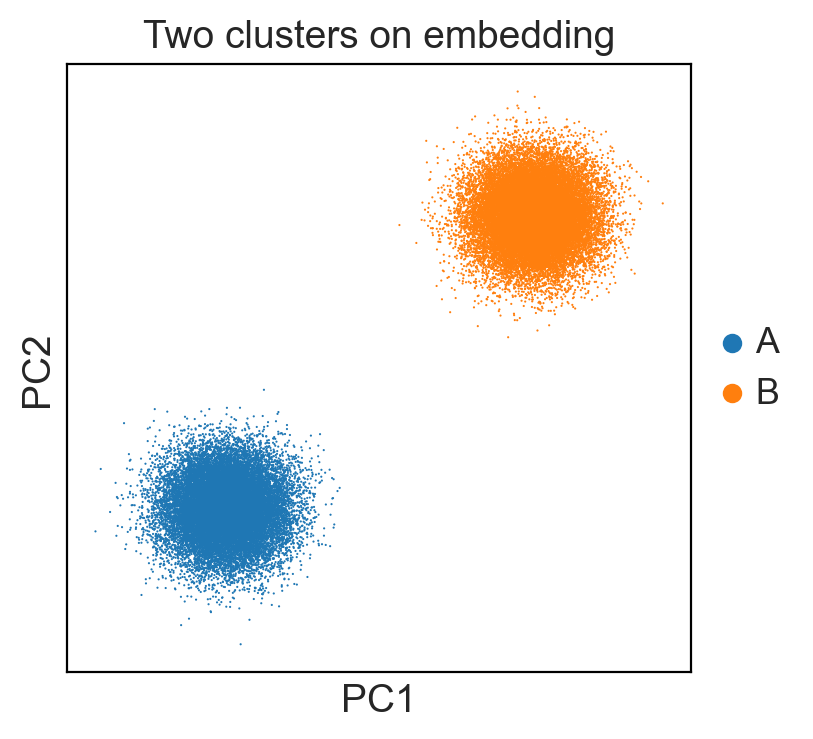

In [87]:
n_cells = coordinates.shape[0]

adata = sc.AnnData(
    X=np.matrix([[0] * n_cells]).T,
    obsm={"X_pca": coordinates},
    obs=pd.DataFrame({
        "clone": labels,
        "p": ps,
        "cluster": cells_labels,
    })
)

sc.pl.pca(adata, color="cluster", title="Two clusters on embedding")

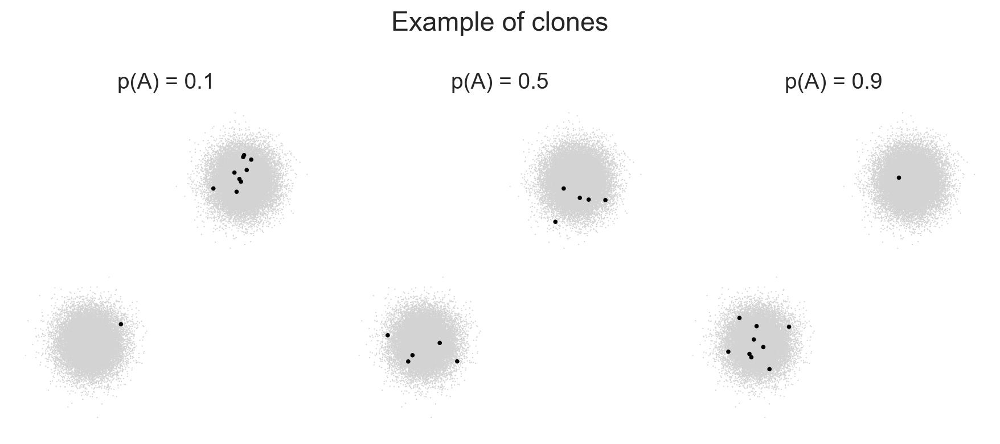

In [437]:
fig, axes = plt.subplots(ncols=3, figsize=(9, 4))
for i, p in enumerate([0.1, 0.5, 0.9]):
    clone = adata[adata.obs.p == p].obs.clone[0]
    sl.pl.clone(adata, "clone", clone, basis="X_pca", ax=axes[i], title=f"p(A) = {p}")
    
fig.suptitle("Example of clones")
fig.tight_layout()

In [73]:
sl.tl.clonal_nn(
    adata,
    obs_name="clone",
    use_rep="X_pca",
    tqdm_bar=True,
)

100%|██████████| 50000/50000 [00:48<00:00, 1039.34it/s]


In [78]:
clones = sl.tl.clone2vec(
    adata,
    obs_name="clone",
    n_epochs=200,
    z_dim=2,
    batch_size=8192,
    device="cuda:0",
)

100%|██████████| 200/200 [12:48<00:00,  3.84s/it]


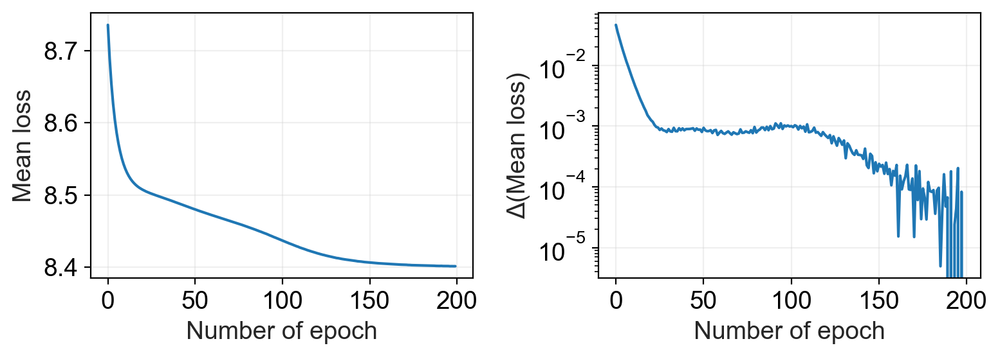

In [79]:
sl.pl.epochs_loss(clones)

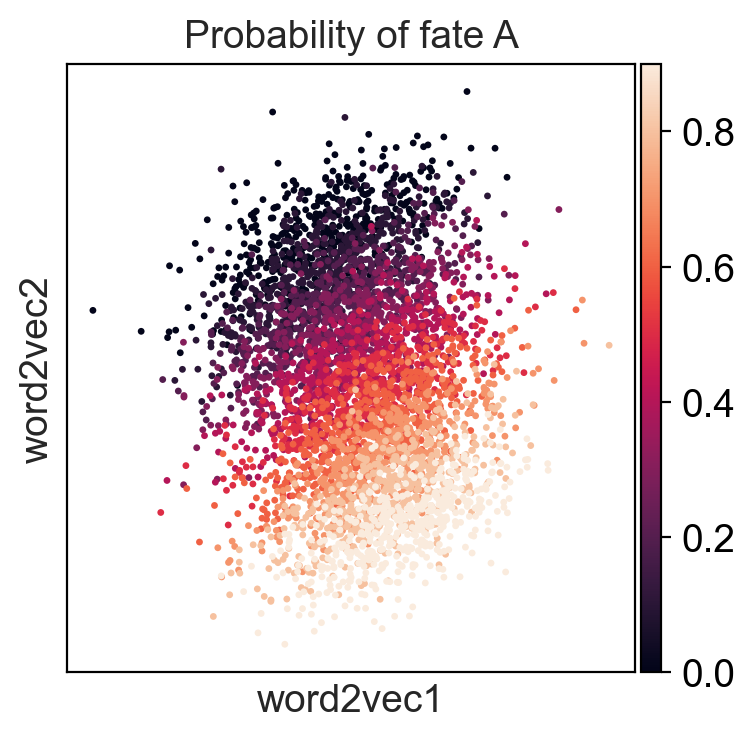

In [88]:
clones.obs["p"] = [clones_ground_truth[clone] for clone in clones.obs_names]
sc.pl.embedding(clones, basis="word2vec", color="p", title="Probability of fate A")

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


Text(0.5, 1.0, "Pearson's r = -0.959")

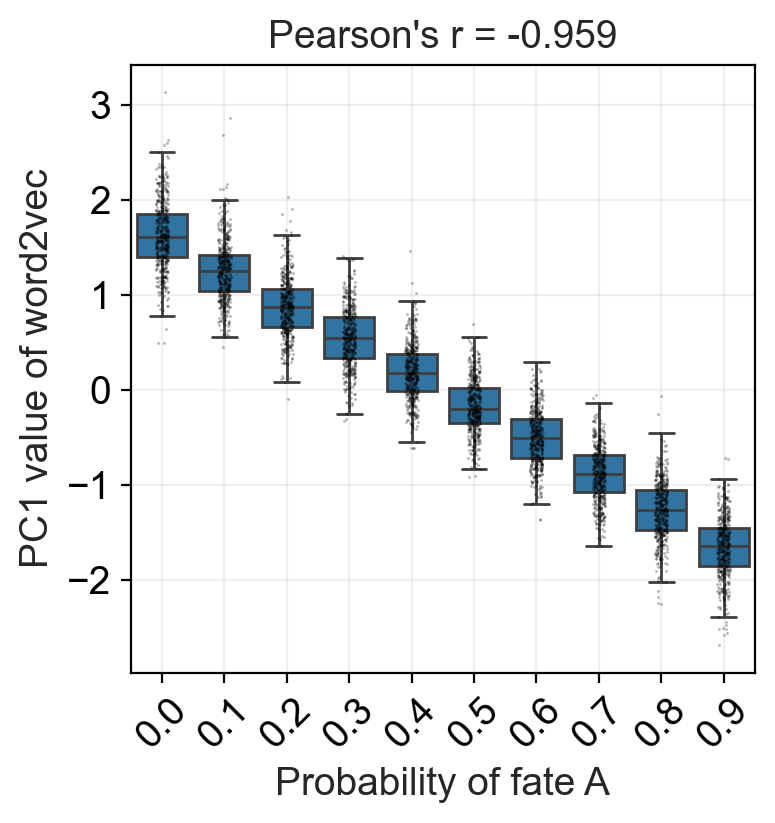

In [128]:
from scipy.stats import spearmanr, pearsonr

fig, ax = plt.subplots(figsize=(4, 4))

sns.boxplot(
    x=np.round(clones.obs.p, 2),
    y=sc.pp.pca(clones.obsm["word2vec"]).T[0],
    ax=ax,
    showfliers=False,
)

sns.stripplot(
    x=np.round(clones.obs.p, 2),
    y=sc.pp.pca(clones.obsm["word2vec"]).T[0],
    ax=ax,
    color="black",
    s=1,
    alpha=0.3,
)

ax.tick_params(axis="x", labelrotation=45)

ax.set_xlabel("Probability of fate A")
ax.set_ylabel("PC1 value of word2vec")

ax.grid(alpha=0.3)

correlation = np.round(pearsonr(
    clones.obs.p,
    sc.pp.pca(clones.obsm["word2vec"]).T[0],
).statistic, 3)

ax.set_title(f"Pearson's r = {correlation}")

In [ ]:
from scipy.sparse import csr_matrix

adata.X = csr_matrix(adata.X)
clones.X = csr_matrix(clones.X)
clones.layers["counts"] = csr_matrix(clones.layers["counts"])
clones.layers["frequencies"] = csr_matrix(clones.layers["frequencies"])

adata.write_h5ad("01_adata.h5ad")
clones.write_h5ad("01_clones.h5ad")

In [415]:
adata = sc.read_h5ad("01_adata.h5ad")
clones = sc.read_h5ad("01_clones.h5ad")

## Discrete behaviour

In [102]:
generate_coordinates = {
    "A": lambda x: np.array([
        np.random.normal(0, size=x),
        np.random.normal(0, size=x),
    ]).T,
    "B": lambda x: np.array([
        np.random.normal(10, size=x),
        np.random.normal(10, size=x),
    ]).T,
    "C": lambda x: np.array([
        np.random.normal(10, size=x),
        np.random.normal(0, size=x),
    ]).T,
}

def create_clone(groups, size=5):
    return np.concatenate([
        generate_coordinates[group](size) for group in groups
    ])

In [117]:
coordinates = []
labels = []
ps = []
clones_ground_truth = {}
cells_labels = []

clone_number = 0
for clone_type in [
    "AAA", "AAB", "AAC",
    "ABB", "ACC", "ABC",
    "BBB", "BBC", "BCC",
    "CCC",
]:
    for i in range(500):
        clone_name = f"clone_{clone_number}"
        clones_ground_truth[clone_name] = clone_type
        coordinates += list(create_clone(clone_type))
        labels += [clone_name] * 15
        ps += [clone_type] * 15
        clone_number += 1
        cells_labels += (
            [clone_type[0]] * 5 +
            [clone_type[1]] * 5 +
            [clone_type[2]] * 5
        )
        
coordinates = np.array(coordinates)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


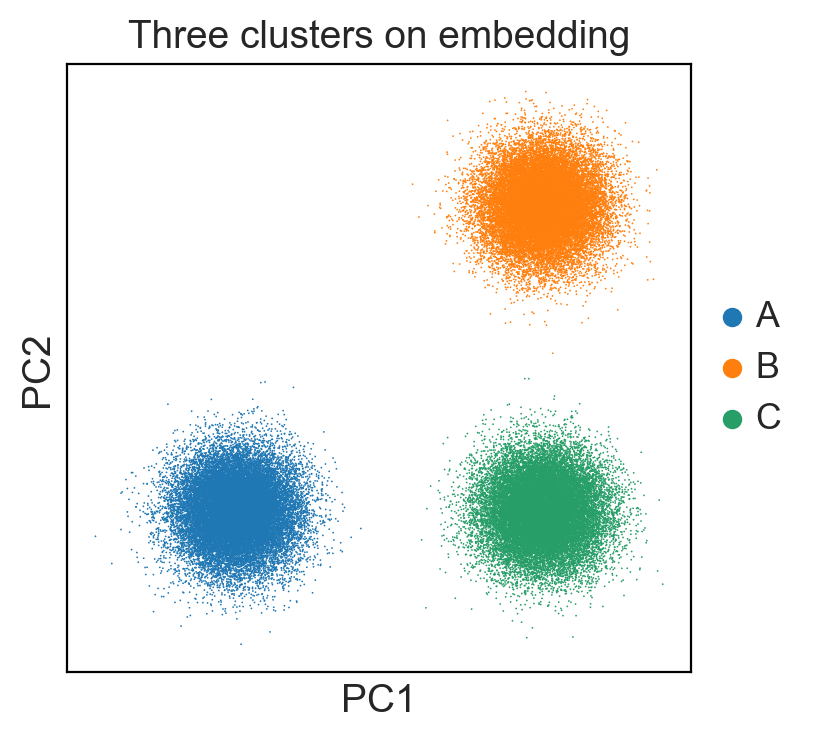

In [118]:
n_cells = coordinates.shape[0]

adata = sc.AnnData(
    X=np.matrix([[0] * n_cells]).T,
    obsm={"X_pca": coordinates},
    obs=pd.DataFrame({
        "clone": labels,
        "clone_type": ps,
        "cluster": cells_labels,
    })
)

sc.pl.pca(adata, color="cluster", title="Three clusters on embedding")

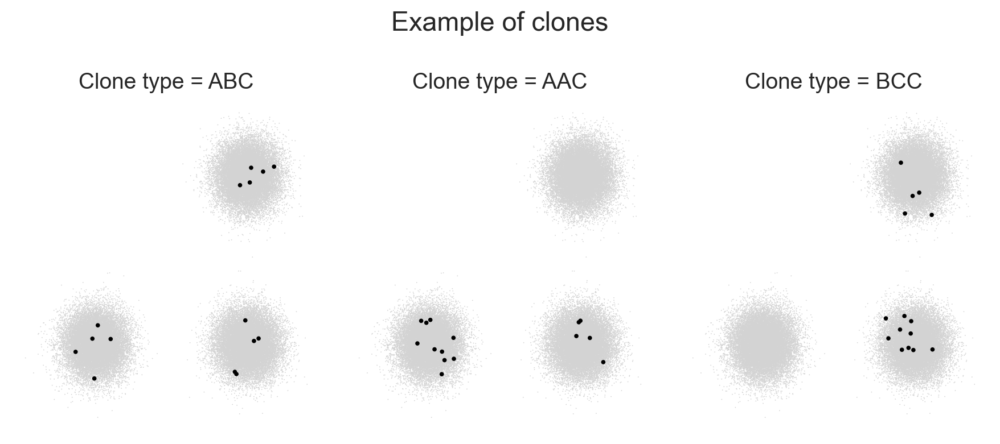

In [443]:
fig, axes = plt.subplots(ncols=3, figsize=(9, 4))
for i, clone_type in enumerate(["ABC", "AAC", "BCC"]):
    clone = adata[adata.obs.clone_type == clone_type].obs.clone[0]
    sl.pl.clone(adata, "clone", clone, basis="X_pca", ax=axes[i], title=f"Clone type = {clone_type}")
    
fig.suptitle("Example of clones")
fig.tight_layout()

In [ ]:
sl.tl.clonal_nn(
    adata,
    obs_name="clone",
    use_rep="X_pca",
    tqdm_bar=True,
    k=30,
)

In [ ]:
clones = sl.tl.clone2vec(
    adata,
    obs_name="clone",
    n_epochs=200,
    z_dim=5,
    batch_size=2**16,
    device="cuda:0",
)

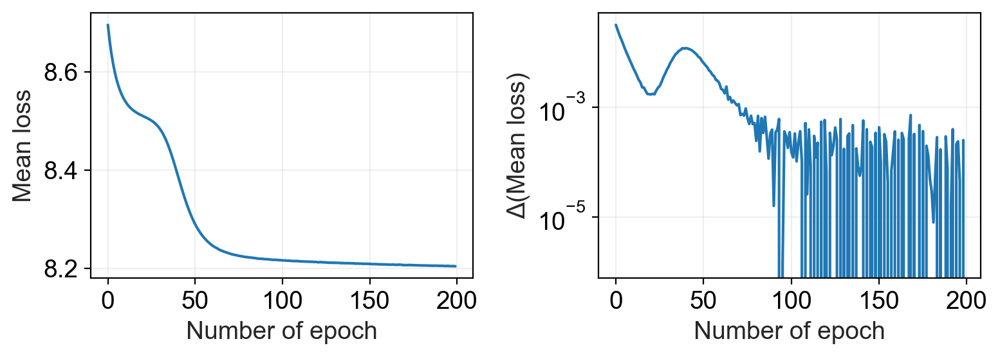

In [121]:
sl.pl.epochs_loss(clones)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


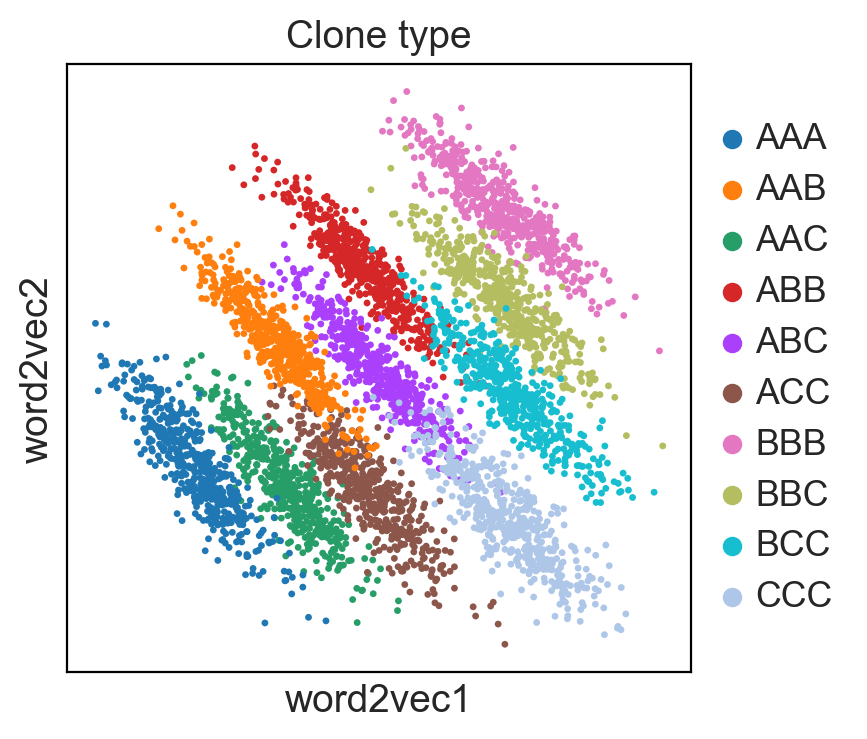

In [147]:
clones.obs["clone_type"] = [clones_ground_truth[clone] for clone in clones.obs_names]

sc.pl.embedding(
    clones,
    color="clone_type",
    basis="word2vec",
    title="Clone type",
    components="1,2",
)

In [122]:
sc.pp.neighbors(clones, use_rep="word2vec", n_neighbors=15)
sc.tl.umap(clones)
sc.tl.leiden(clones)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


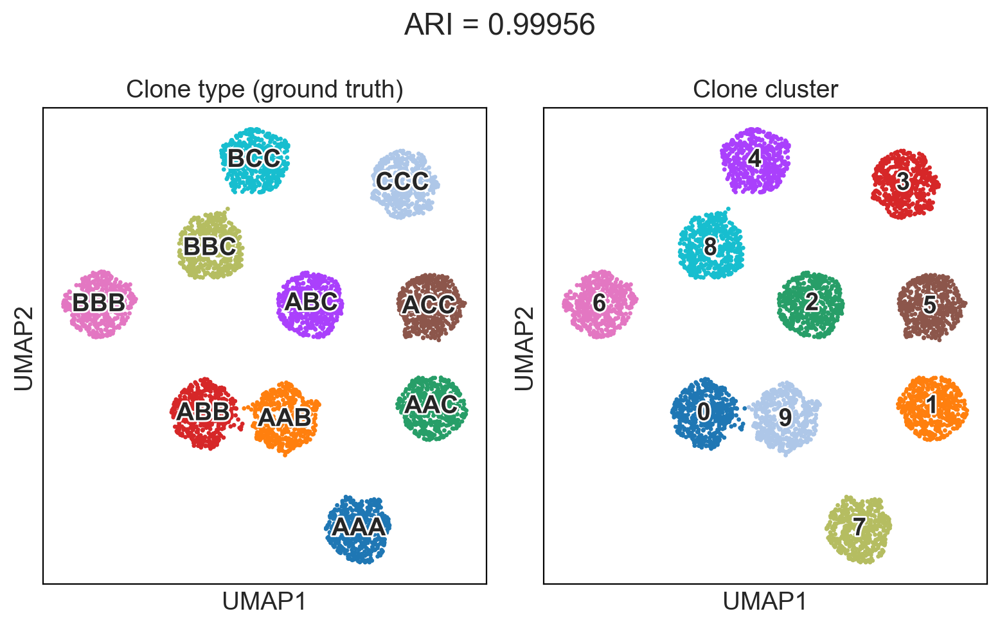

In [155]:
from sklearn.metrics import adjusted_rand_score

fig, axes = plt.subplots(ncols=2, figsize=(8, 5))
sc.pl.umap(clones, color="clone_type", title="Clone type (ground truth)", ax=axes[0], show=False, 
           legend_loc="on data", legend_fontoutline=2)
sc.pl.umap(clones, color="leiden", title="Clone cluster", ax=axes[1], show=False, 
           legend_loc="on data", legend_fontoutline=2)

fig.suptitle(f"ARI = {np.round(adjusted_rand_score(clones.obs.clone_type, clones.obs.leiden), 5)}")

fig.tight_layout()

In [162]:
from scipy.sparse import csr_matrix

adata.X = csr_matrix(adata.X)
clones.X = csr_matrix(clones.X)
clones.layers["counts"] = csr_matrix(clones.layers["counts"])
clones.layers["frequencies"] = csr_matrix(clones.layers["frequencies"])

adata.write_h5ad("02_adata.h5ad")
clones.write_h5ad("02_clones.h5ad")

In [439]:
adata = sc.read_h5ad("02_adata.h5ad")
clones = sc.read_h5ad("02_clones.h5ad")

## Complex gene expression embedding

In [33]:
def rotate_points(x, y, angle_degrees):
    angle_radians = np.radians(angle_degrees)
    rotation_matrix = np.array([
        [np.cos(angle_radians), np.sin(angle_radians)],
        [-np.sin(angle_radians), np.cos(angle_radians)],
    ])
    points = np.vstack((x, y))
    rotated_points = np.dot(rotation_matrix, points)

    return rotated_points

In [62]:
coordinates = []
labels = []
cells_labels = []
clones_ground_truth = {}

n_clones = 500
clone_size = 40
clone_number = 0

# Group `O`
for i in range(n_clones):
    angles = np.random.uniform(0, 2 * np.pi, clone_size)
    radii = np.random.uniform(1.5, 2, clone_size)
    coordinates += list(np.array([
        radii * np.cos(angles),
        radii * np.sin(angles),
    ]).T)
    
    clones_ground_truth[f"clone_{clone_number}"] = "O"
    labels += [f"clone_{clone_number}"] * clone_size
    cells_labels += ["O"] * clone_size
    clone_number += 1
    
# Group `o`
for i in range(n_clones):
    angles = np.random.uniform(0, 2 * np.pi, clone_size)
    radii = np.random.uniform(0.5, 1, clone_size)
    coordinates += list(np.array([
        radii * np.cos(angles),
        radii * np.sin(angles),
    ]).T)
    
    clones_ground_truth[f"clone_{clone_number}"] = "o"
    labels += [f"clone_{clone_number}"] * clone_size
    cells_labels += ["o"] * clone_size
    clone_number += 1
    
# Group `+`
for i in range(n_clones):
    x_h = np.random.uniform(-2, 2, clone_size // 2)
    y_h = np.random.uniform(-0.25, 0.25, clone_size // 2)
    x_v = np.random.uniform(-0.25, 0.25, clone_size // 2)
    y_v = np.random.uniform(-2, 2, clone_size // 2)
    coordinates += list(np.array([
        np.concatenate([x_h, x_v]),
        np.concatenate([y_h, y_v]),
    ]).T)
    
    clones_ground_truth[f"clone_{clone_number}"] = "+"
    labels += [f"clone_{clone_number}"] * clone_size
    cells_labels += ["+"] * clone_size
    clone_number += 1
    
# Clonal group `+ (22.5°)`
for i in range(n_clones):
    x_h = np.random.uniform(-2, 2, clone_size // 2)
    y_h = np.random.uniform(-0.25, 0.25, clone_size // 2)
    x_v = np.random.uniform(-0.25, 0.25, clone_size // 2)
    y_v = np.random.uniform(-2, 2, clone_size // 2)
    coordinates += list(rotate_points(
        np.concatenate([x_h, x_v]),
        np.concatenate([y_h, y_v]),
        22.5
    ).T)
    
    clones_ground_truth[f"clone_{clone_number}"] = "+ (22.5°)"
    labels += [f"clone_{clone_number}"] * clone_size
    cells_labels += ["+ (22.5°)"] * clone_size
    clone_number += 1
    
# Clonal group `+ (45°)`
for i in range(n_clones):
    x_h = np.random.uniform(-2, 2, clone_size // 2)
    y_h = np.random.uniform(-0.25, 0.25, clone_size // 2)
    x_v = np.random.uniform(-0.25, 0.25, clone_size // 2)
    y_v = np.random.uniform(-2, 2, clone_size // 2)
    coordinates += list(rotate_points(
        np.concatenate([x_h, x_v]),
        np.concatenate([y_h, y_v]),
        22.5 * 2
    ).T)
    
    clones_ground_truth[f"clone_{clone_number}"] = "+ (45°)"
    labels += [f"clone_{clone_number}"] * clone_size
    cells_labels += ["+ (45°)"] * clone_size
    clone_number += 1
    
# Clonal group `+ (67.7°)`
for i in range(n_clones):
    x_h = np.random.uniform(-2, 2, clone_size // 2)
    y_h = np.random.uniform(-0.25, 0.25, clone_size // 2)
    x_v = np.random.uniform(-0.25, 0.25, clone_size // 2)
    y_v = np.random.uniform(-2, 2, clone_size // 2)
    coordinates += list(rotate_points(
        np.concatenate([x_h, x_v]),
        np.concatenate([y_h, y_v]),
        22.5 * 3
    ).T)
    
    clones_ground_truth[f"clone_{clone_number}"] = "+ (67.7°)"
    labels += [f"clone_{clone_number}"] * clone_size
    cells_labels += ["+ (67.7°)"] * clone_size
    clone_number += 1

coordinates = np.array(coordinates)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


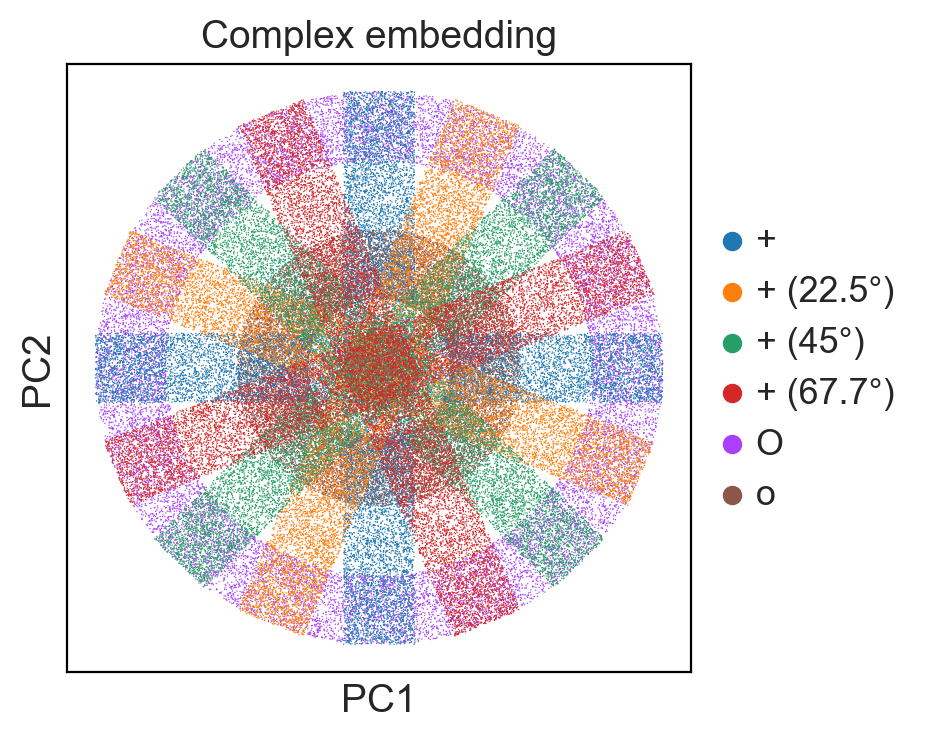

In [63]:
n_cells = coordinates.shape[0]

adata = sc.AnnData(
    X=np.matrix([[0] * n_cells]).T,
    obsm={"X_pca": coordinates},
    obs=pd.DataFrame({
        "clone": labels,
        "cluster": cells_labels,
    })
)

sc.pl.pca(adata, color="cluster", title="Complex embedding")

In [64]:
sl.tl.clonal_nn(
    adata,
    obs_name="clone",
    use_rep="X_pca",
    tqdm_bar=True,
    k=30,
)

100%|██████████| 120000/120000 [01:59<00:00, 1006.30it/s]


In [ ]:
clones = sl.tl.clone2vec(
    adata,
    obs_name="clone",
    n_epochs=200,
    z_dim=5,
    batch_size=2**16,
    device="cuda:0",
)

 69%|██████▉   | 138/200 [46:53<20:42, 20.04s/it]]

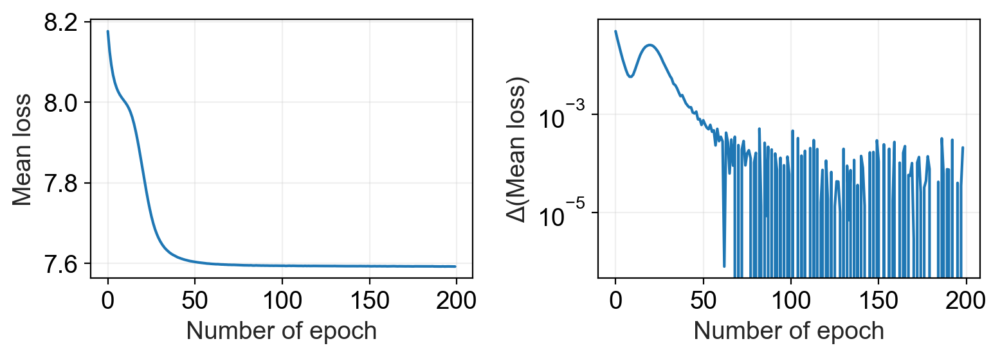

In [66]:
sl.pl.epochs_loss(clones)

In [67]:
sc.pp.neighbors(clones, use_rep="word2vec", n_neighbors=15)
sc.tl.umap(clones)

In [71]:
clones.obs["clone_type"] = [clones_ground_truth[clone] for clone in clones.obs_names]
sc.tl.leiden(clones, resolution=0.5)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


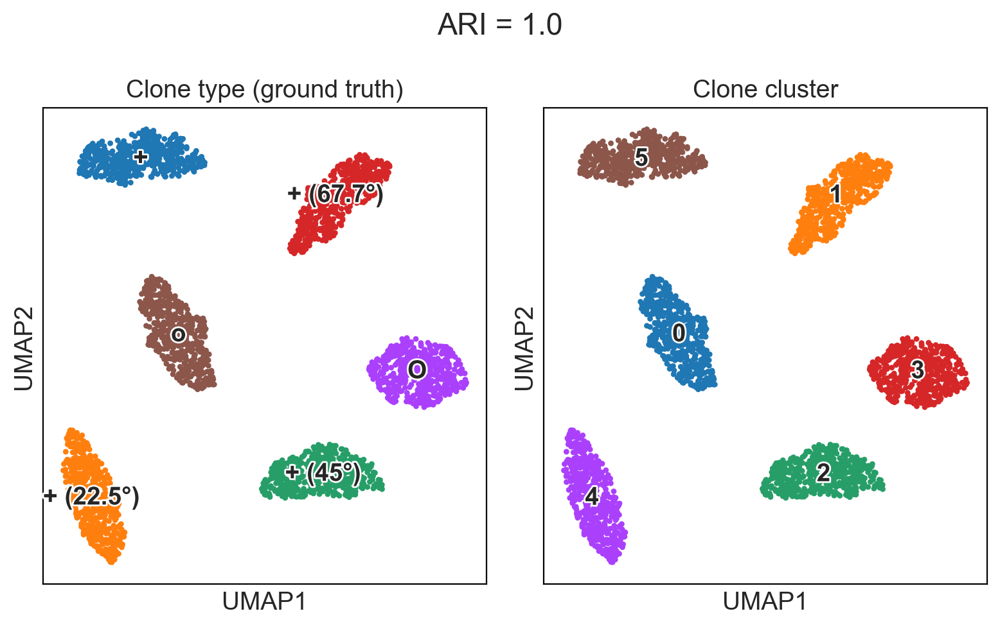

In [72]:
from sklearn.metrics import adjusted_rand_score

fig, axes = plt.subplots(ncols=2, figsize=(8, 5))
sc.pl.umap(clones, color="clone_type", title="Clone type (ground truth)", ax=axes[0], show=False, 
           legend_loc="on data", legend_fontoutline=2)
sc.pl.umap(clones, color="leiden", title="Clone cluster", ax=axes[1], show=False, 
           legend_loc="on data", legend_fontoutline=2)

fig.suptitle(f"ARI = {np.round(adjusted_rand_score(clones.obs.clone_type, clones.obs.leiden), 5)}")

fig.tight_layout()

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


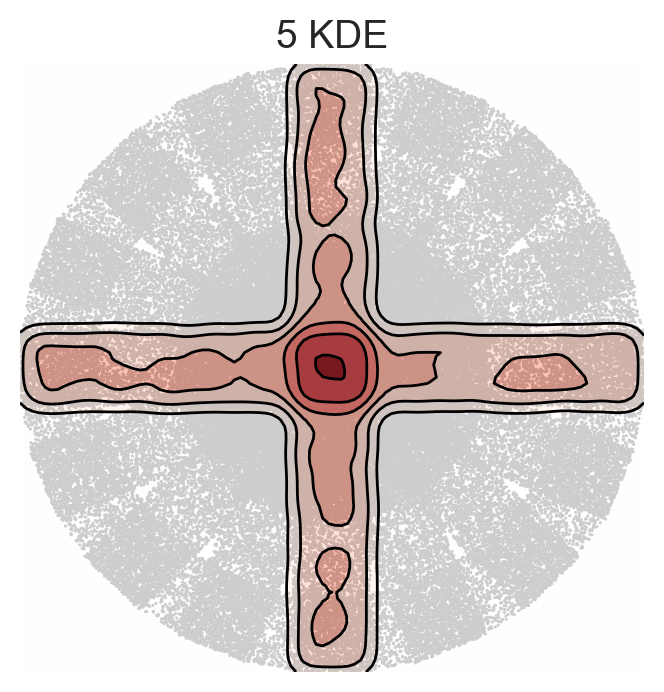

In [77]:
sl.tl.transfer_clonal_annotation(
    adata=adata,
    clones=clones,
    adata_clone_name="clone",
    adata_obs_name="clonal_cluster",
    clones_obs_name="leiden",
)

sl.pl.kde(adata, basis="X_pca", groupby="clonal_cluster", group="5")

In [78]:
from scipy.sparse import csr_matrix

adata.X = csr_matrix(adata.X)
clones.X = csr_matrix(clones.X)
clones.layers["counts"] = csr_matrix(clones.layers["counts"])
clones.layers["frequencies"] = csr_matrix(clones.layers["frequencies"])

adata.write_h5ad("03_adata.h5ad")
clones.write_h5ad("03_clones.h5ad")

## Stability to subsampling

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


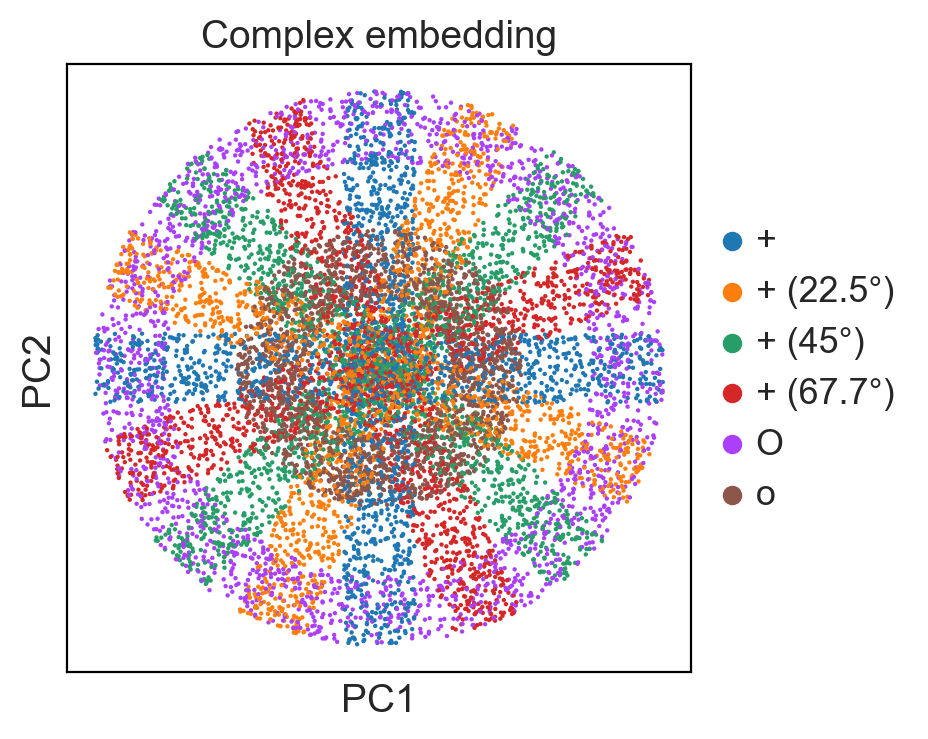

In [92]:
fraction = 0.1

adata = sc.read_h5ad("03_adata.h5ad")
adata = adata[pd.Series(adata.obs_names).sample(frac=fraction).index].copy()

sc.pl.pca(adata, color="cluster", title="Complex embedding")

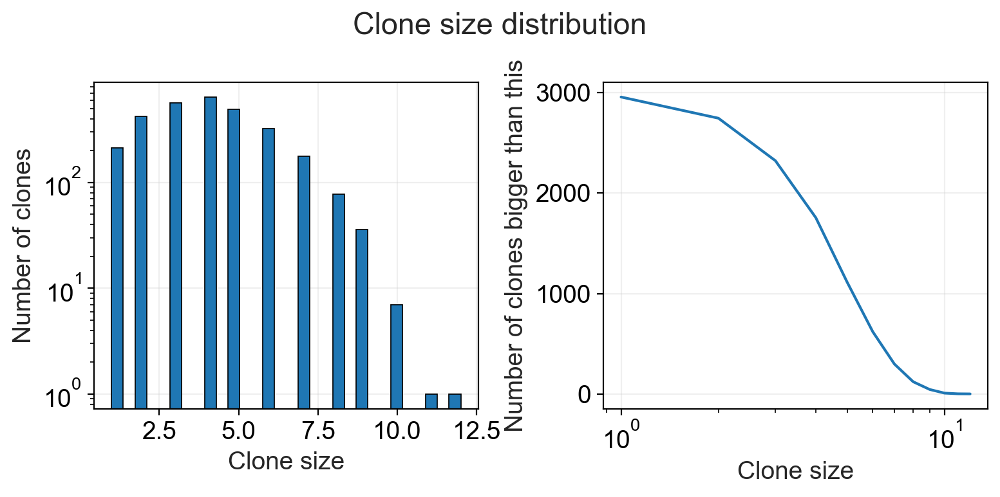

In [93]:
sl.pl.basic_stats(adata, "clone")

In [94]:
sl.tl.clonal_nn(
    adata,
    obs_name="clone",
    use_rep="X_pca",
    tqdm_bar=True,
    k=30,
    min_size=3,
)

100%|██████████| 12000/12000 [00:12<00:00, 983.68it/s] 


In [ ]:
clones = sl.tl.clone2vec(
    adata,
    obs_name="clone",
    n_epochs=600,
    z_dim=5,
    batch_size=2**16,
    device="cuda:0",
)

  2%|▎         | 15/600 [00:24<15:57,  1.64s/it]

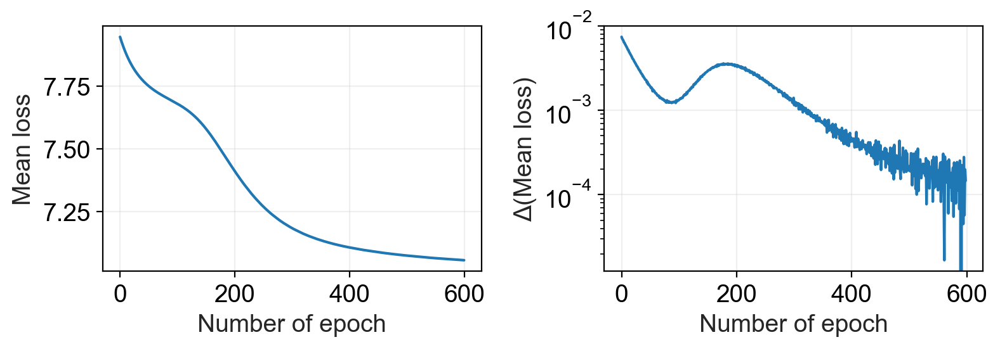

In [119]:
sl.pl.epochs_loss(clones)

In [134]:
sc.pp.neighbors(clones, use_rep="word2vec", n_neighbors=30)
sc.tl.umap(clones, min_dist=0.3)

In [135]:
clones.obs["clone_type"] = [clones_ground_truth[clone] for clone in clones.obs_names]
sc.tl.leiden(clones, resolution=0.5)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


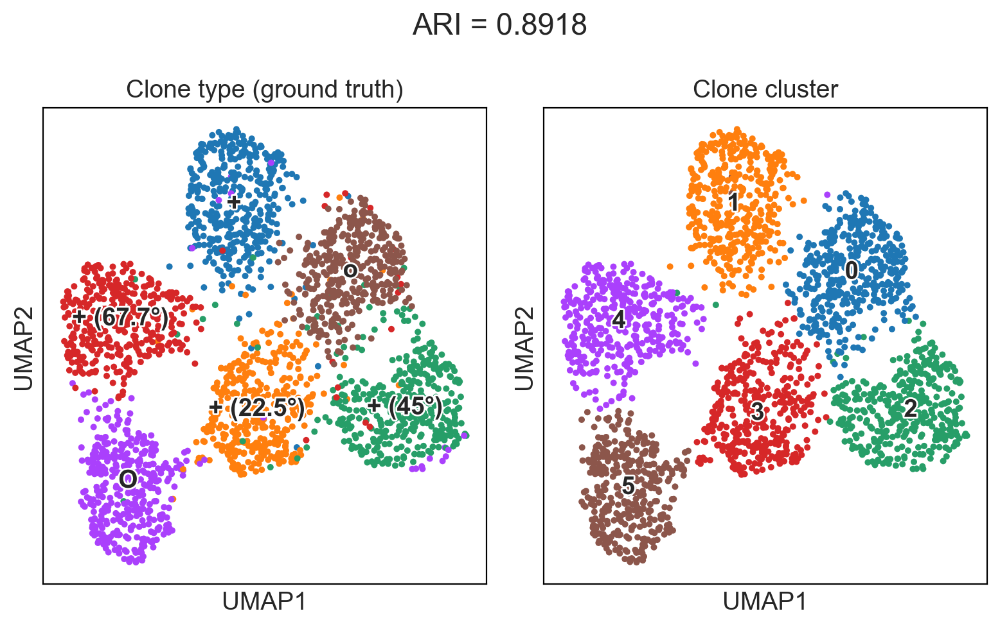

In [136]:
from sklearn.metrics import adjusted_rand_score

fig, axes = plt.subplots(ncols=2, figsize=(8, 5))
sc.pl.umap(clones, color="clone_type", title="Clone type (ground truth)", ax=axes[0], show=False, 
           legend_loc="on data", legend_fontoutline=2)
sc.pl.umap(clones, color="leiden", title="Clone cluster", ax=axes[1], show=False, 
           legend_loc="on data", legend_fontoutline=2)

fig.suptitle(f"ARI = {np.round(adjusted_rand_score(clones.obs.clone_type, clones.obs.leiden), 5)}")

fig.tight_layout()

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


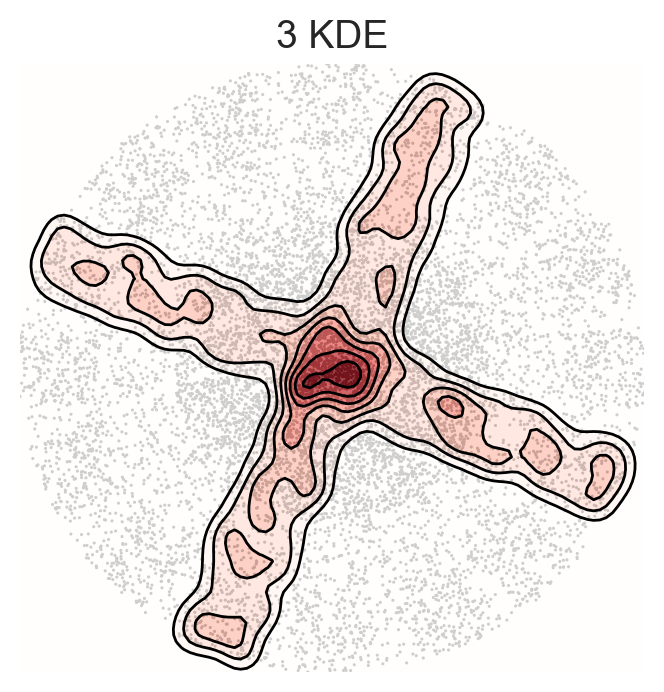

In [230]:
sl.tl.transfer_clonal_annotation(
    adata=adata,
    clones=clones,
    adata_clone_name="clone",
    adata_obs_name="clonal_cluster",
    clones_obs_name="leiden",
)

sl.pl.kde(adata, basis="X_pca", groupby="clonal_cluster", group="3")

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


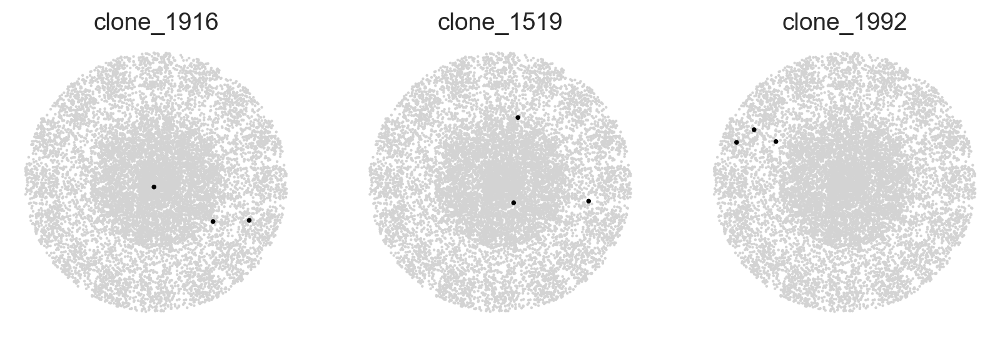

In [291]:
examples = pd.Series(list(set(
    adata[adata.obs.clonal_cluster == "3"].obs.clone
))).sample(3).values

fig, axes = plt.subplots(ncols=3, figsize=(10, 3))
for i, clone in enumerate(examples):
    sl.pl.clone(
        adata,
        clone_col="clone",
        clone_name=clone,
        ax=axes[i],
        basis="X_pca",
    )

In [139]:
from scipy.sparse import csr_matrix

adata.X = csr_matrix(adata.X)
clones.X = csr_matrix(clones.X)
clones.layers["counts"] = csr_matrix(clones.layers["counts"])
clones.layers["frequencies"] = csr_matrix(clones.layers["frequencies"])

adata.write_h5ad("04_adata.h5ad")
clones.write_h5ad("04_clones.h5ad")

## Efefct of clone size

In [254]:
clones = sc.read_h5ad("04_clones.h5ad")
adata = sc.read_h5ad("04_adata.h5ad")

clones = sl.tl.refill_ct(
    adata,
    obs_name="clone",
    ct_col="cluster",
    clones=clones,
)

n_cells = clones.X.sum(axis=1)
clones.obs["n_cells"] = n_cells

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


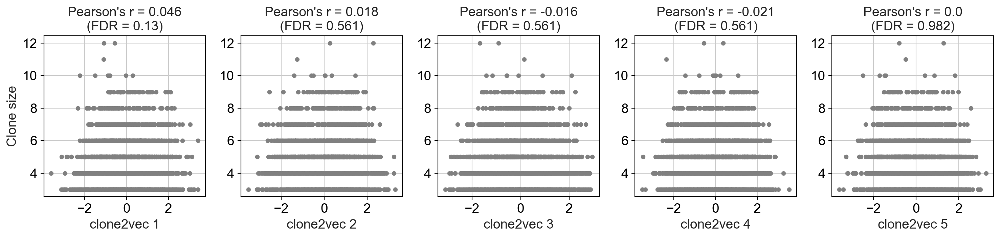

In [255]:
from scipy.stats import pearsonr
from statsmodels.stats.multitest import multipletests

fig, axes = plt.subplots(ncols=5, figsize=(15, 3.75))

ps = []
rs = []

for i in range(5):
    rs.append(np.round(pearsonr(clones.obsm["word2vec"][:, i], clones.obs["n_cells"]).statistic, 3))
    ps.append(np.round(pearsonr(clones.obsm["word2vec"][:, i], clones.obs["n_cells"]).pvalue, 3))
    
ps = [np.round(i, 3) for i in multipletests(ps, method="fdr_bh")[1]]

for i in range(5):
    sns.scatterplot(
        x=clones.obsm["word2vec"][:, i],
        y=clones.obs["n_cells"],
        edgecolor=None,
        color="grey",
        ax=axes[i],
        s=20,
    )
    
    axes[i].set_xlabel(f"clone2vec {i + 1}")
    if i == 0:
        axes[i].set_ylabel("Clone size")
    else:
        axes[i].set_ylabel("")
    axes[i].set_title(f"Pearson's r = {rs[i]}\n(FDR = {ps[i]})")
        
fig.tight_layout()

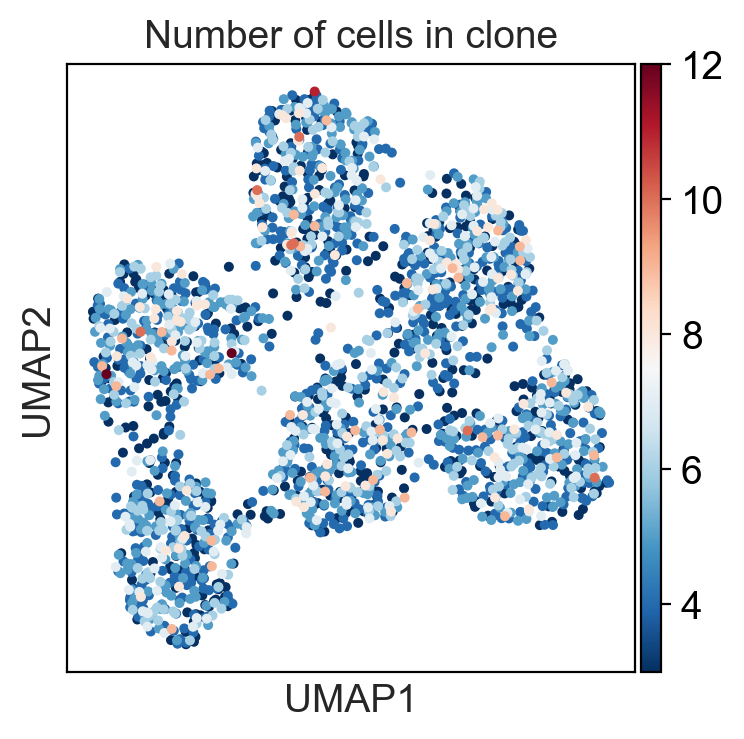

In [256]:
sc.pl.umap(
    clones,
    color="n_cells",
    cmap="RdBu_r",
    title="Number of cells in clone",
)

## Comparison to scRNA-Seq-like approach

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


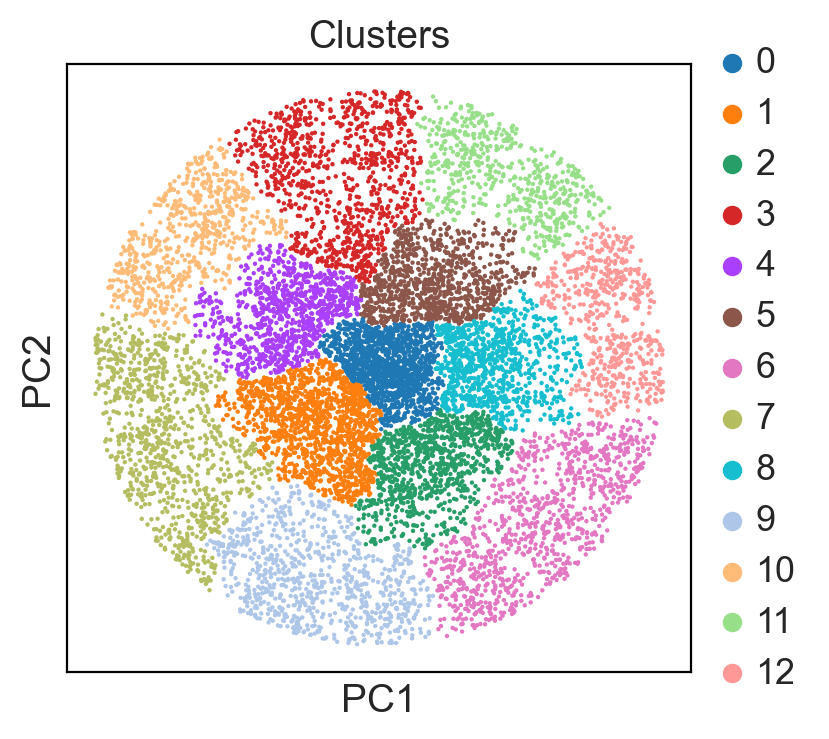

In [409]:
clones = sc.read_h5ad("04_clones.h5ad")
adata = sc.read_h5ad("04_adata.h5ad")

sc.pp.neighbors(adata, use_rep="X_pca")
sc.tl.leiden(adata, resolution=0.1)

sc.pl.pca(adata, color="leiden", title="Clusters")

In [410]:
clones = sl.tl.refill_ct(
    adata,
    obs_name="clone",
    ct_col="leiden",
    clones=clones,
)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [411]:
# scRNA-Seq-like preprocessing

sc.pp.normalize_total(clones)
sc.pp.log1p(clones)
sc.pp.pca(clones, n_comps=5)
sc.pp.neighbors(clones, use_rep="X_pca")
sc.tl.umap(clones, min_dist=0.3)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


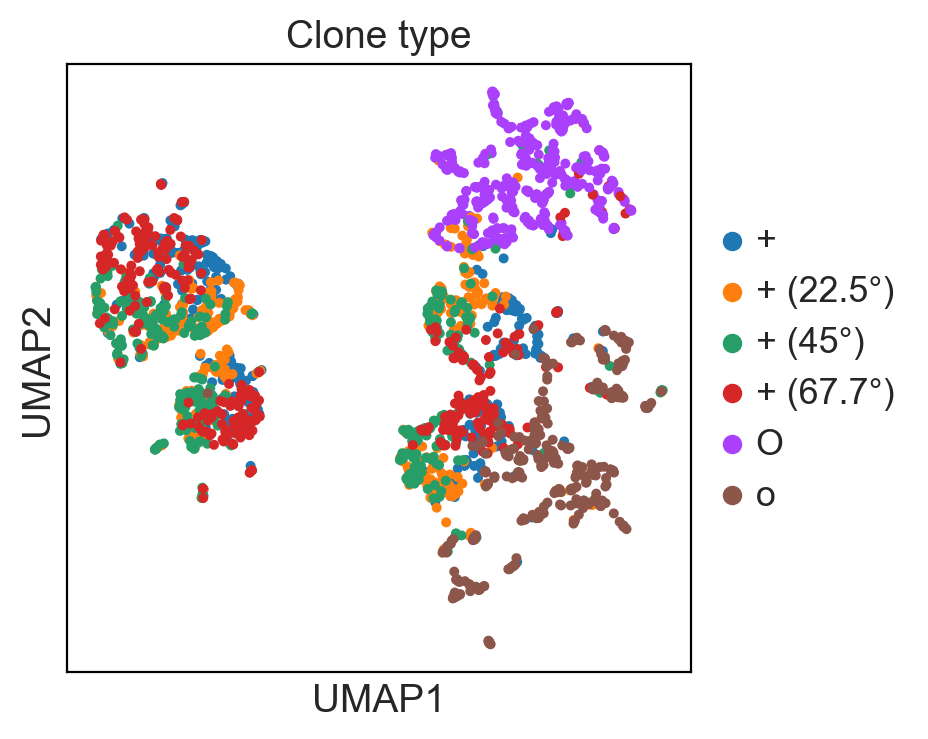

In [412]:
sc.pl.umap(clones, color="clone_type", title="Clone type")

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


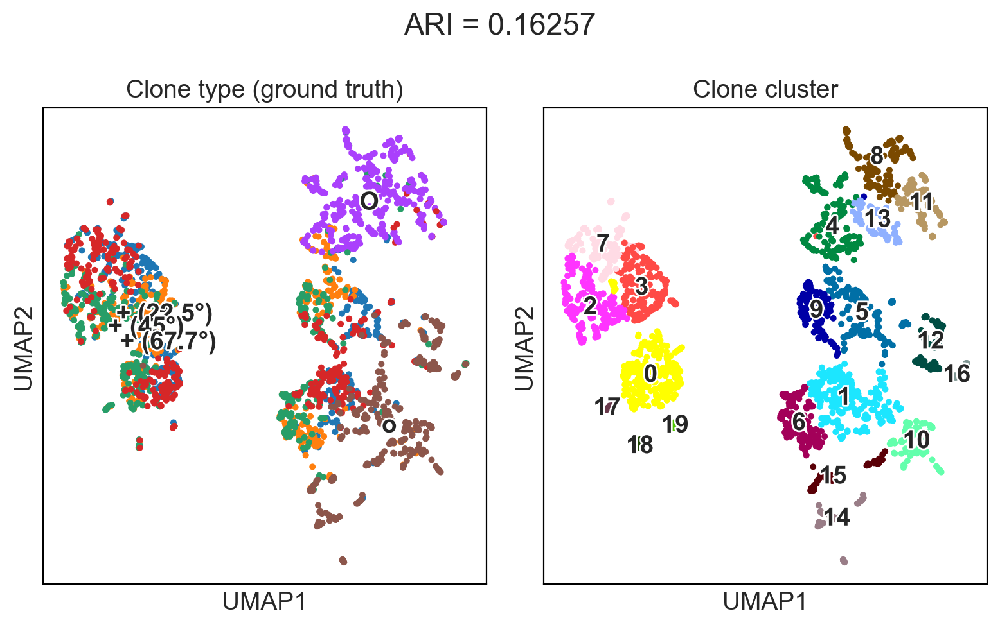

In [414]:
sc.tl.leiden(clones, resolution=0.5)

from sklearn.metrics import adjusted_rand_score

fig, axes = plt.subplots(ncols=2, figsize=(8, 5))
sc.pl.umap(clones, color="clone_type", title="Clone type (ground truth)", ax=axes[0], show=False, 
           legend_loc="on data", legend_fontoutline=2)
sc.pl.umap(clones, color="leiden", title="Clone cluster", ax=axes[1], show=False, 
           legend_loc="on data", legend_fontoutline=2)

fig.suptitle(f"ARI = {np.round(adjusted_rand_score(clones.obs.clone_type, clones.obs.leiden), 5)}")

fig.tight_layout()

## Even more complex behaviour with less cells

In [292]:
def rotate_points(x, y, angle_degrees):
    angle_radians = np.radians(angle_degrees)
    rotation_matrix = np.array([
        [np.cos(angle_radians), np.sin(angle_radians)],
        [-np.sin(angle_radians), np.cos(angle_radians)],
    ])
    points = np.vstack((x, y))
    rotated_points = np.dot(rotation_matrix, points)

    return rotated_points

In [305]:
coordinates = []
labels = []
cells_labels = []
clones_ground_truth = {}

n_clones = 300
clone_size = 30
clone_number = 0

for start in [0, 0.5, 1, 1.5]:
    for i in range(n_clones):
        angles = np.random.uniform(0, 2 * np.pi, clone_size)
        radii = np.random.uniform(start, start + 0.5, clone_size)
        coordinates += list(np.array([
            radii * np.cos(angles),
            radii * np.sin(angles),
        ]).T)

        clones_ground_truth[f"clone_{clone_number}"] = f"O ({start} - {start + 0.5})"
        labels += [f"clone_{clone_number}"] * clone_size
        cells_labels += [f"O ({start} - {start + 0.5})"] * clone_size
        clone_number += 1
        
for angle in np.arange(0, 90, step=15):
    for i in range(n_clones):
        x_h = np.random.uniform(-2, 2, clone_size // 2)
        y_h = np.random.uniform(-0.25, 0.25, clone_size // 2)
        x_v = np.random.uniform(-0.25, 0.25, clone_size // 2)
        y_v = np.random.uniform(-2, 2, clone_size // 2)
        coordinates += list(rotate_points(
            np.concatenate([x_h, x_v]),
            np.concatenate([y_h, y_v]),
            angle
        ).T)
    
        clones_ground_truth[f"clone_{clone_number}"] = f"+ ({angle}°)"
        labels += [f"clone_{clone_number}"] * clone_size
        cells_labels += [f"+ ({angle}°)"] * clone_size
        clone_number += 1

coordinates = np.array(coordinates)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


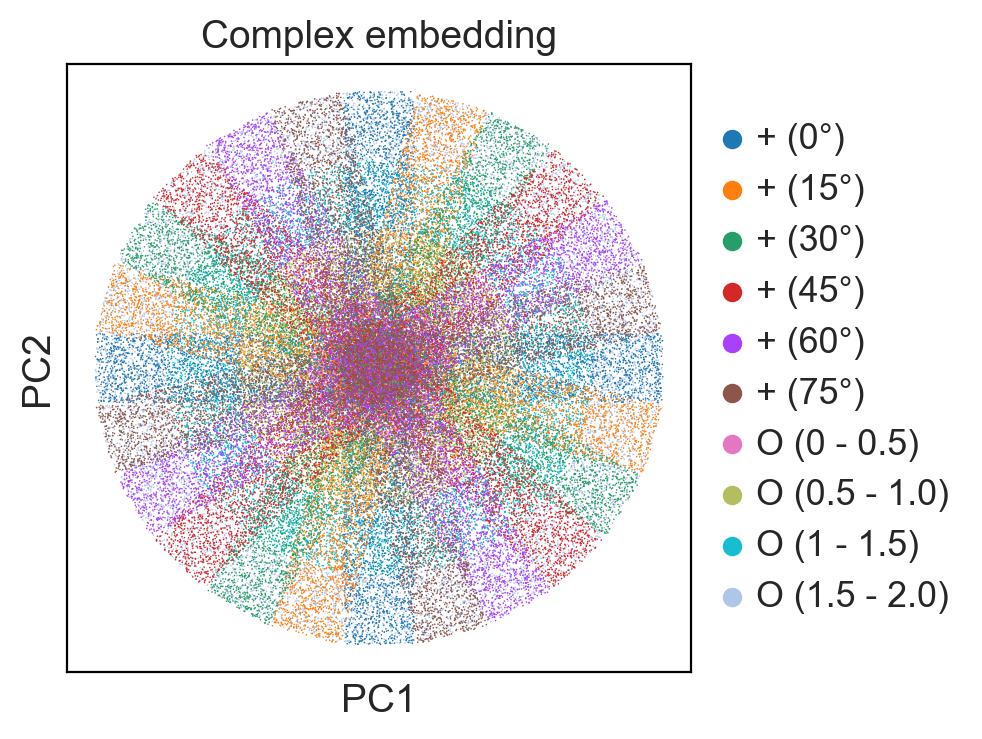

In [306]:
n_cells = coordinates.shape[0]

adata = sc.AnnData(
    X=np.matrix([[0] * n_cells]).T,
    obsm={"X_pca": coordinates},
    obs=pd.DataFrame({
        "clone": labels,
        "cluster": cells_labels,
    })
)

sc.pl.pca(adata, color="cluster", title="Complex embedding")

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided 

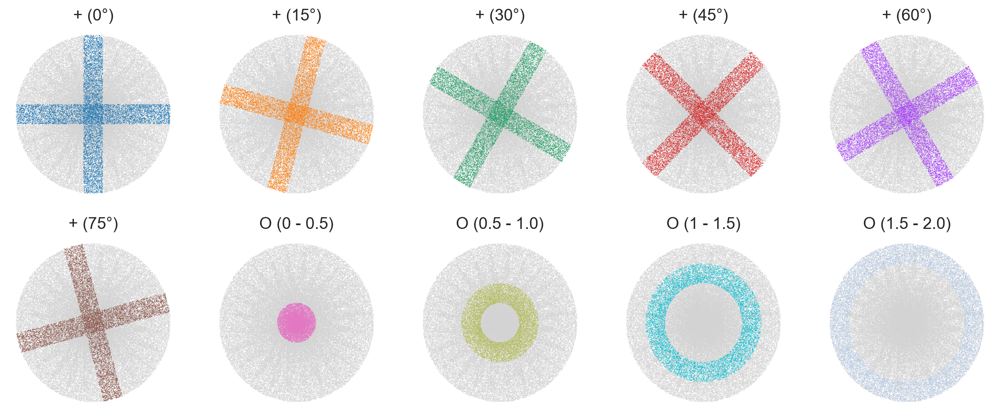

In [505]:
fig, axes = plt.subplots(ncols=5, nrows=2, figsize=(15, 6))

for i, cluster in enumerate(adata.obs.cluster.cat.categories[:5]):
    sc.pl.pca(adata, color="cluster", groups=[cluster], title=cluster, legend_loc=None, ax=axes[0, i], frameon=False, show=False)
    
for i, cluster in enumerate(adata.obs.cluster.cat.categories[-5:]):
    sc.pl.pca(adata, color="cluster", groups=[cluster], title=cluster, legend_loc=None, ax=axes[1, i], frameon=False, show=False)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


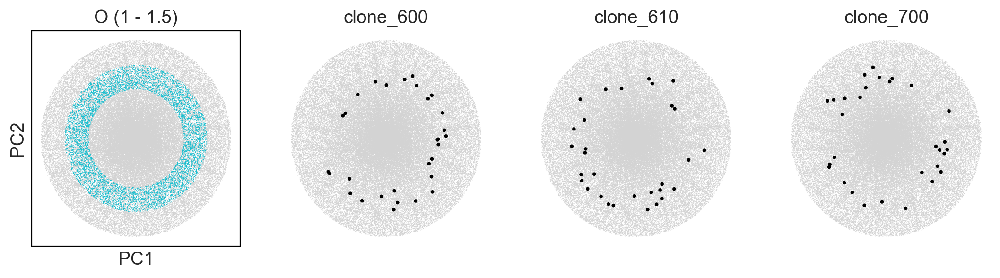

In [499]:
fig, axes = plt.subplots(ncols=4, figsize=(13, 3))

clone_1 = adata[adata.obs.cluster == "O (1 - 1.5)"].obs.clone.cat.categories[0]
clone_2 = adata[adata.obs.cluster == "O (1 - 1.5)"].obs.clone.cat.categories[10]
clone_3 = adata[adata.obs.cluster == "O (1 - 1.5)"].obs.clone.cat.categories[100]

sc.pl.pca(adata, color="cluster", title="O (1 - 1.5)", groups=["O (1 - 1.5)"], legend_loc=None, ax=axes[0], show=False)
sl.pl.clone(adata, clone_col="clone", clone_name=clone_1, basis="X_pca", ax=axes[1])
sl.pl.clone(adata, clone_col="clone", clone_name=clone_2, basis="X_pca", ax=axes[2])
sl.pl.clone(adata, clone_col="clone", clone_name=clone_3, basis="X_pca", ax=axes[3])

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


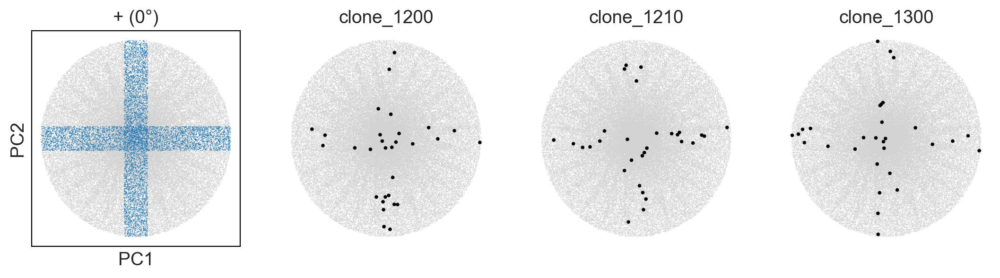

In [498]:
fig, axes = plt.subplots(ncols=4, figsize=(13, 3))

clone_1 = adata[adata.obs.cluster == "+ (0°)"].obs.clone.cat.categories[0]
clone_2 = adata[adata.obs.cluster == "+ (0°)"].obs.clone.cat.categories[10]
clone_3 = adata[adata.obs.cluster == "+ (0°)"].obs.clone.cat.categories[100]

sc.pl.pca(adata, color="cluster", title="+ (0°)", groups=["+ (0°)"], legend_loc=None, ax=axes[0], show=False)
sl.pl.clone(adata, clone_col="clone", clone_name=clone_1, basis="X_pca", ax=axes[1])
sl.pl.clone(adata, clone_col="clone", clone_name=clone_2, basis="X_pca", ax=axes[2])
sl.pl.clone(adata, clone_col="clone", clone_name=clone_3, basis="X_pca", ax=axes[3])

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


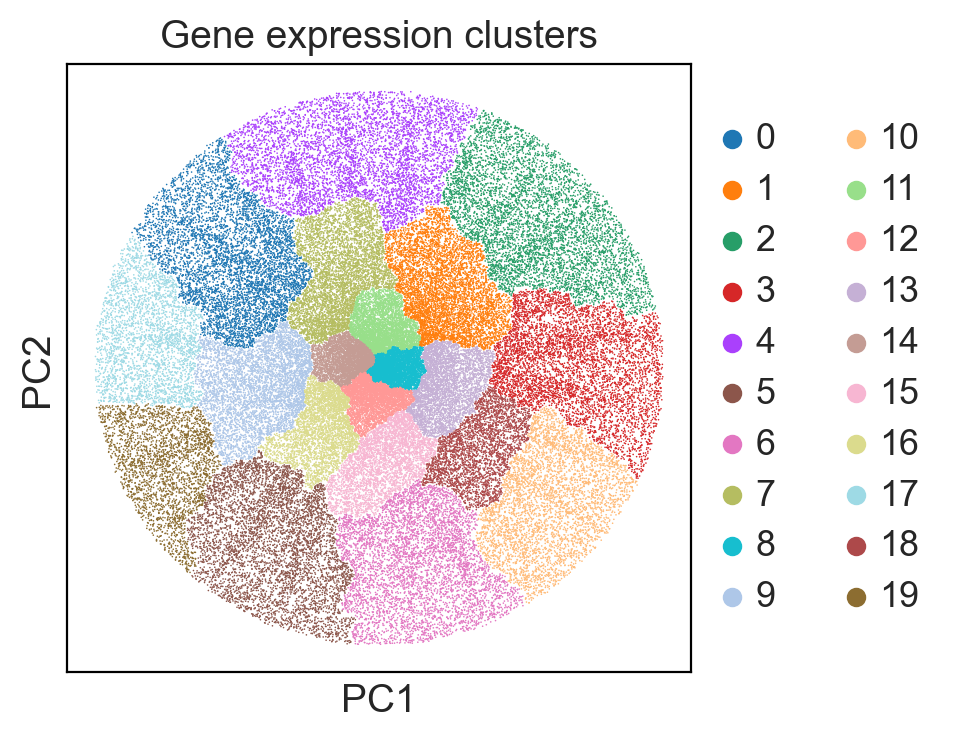

In [309]:
sc.pp.neighbors(adata, use_rep="X_pca")
sc.tl.leiden(adata, resolution=0.1)

sc.pl.pca(adata, color="leiden", title="Gene expression clusters")

In [308]:
sl.tl.clonal_nn(
    adata,
    obs_name="clone",
    use_rep="X_pca",
    tqdm_bar=True,
    k=30,
)

100%|██████████| 90000/90000 [01:29<00:00, 1002.99it/s]


In [310]:
clones = sl.tl.clone2vec(
    adata,
    fill_ct="leiden",
    obs_name="clone",
    n_epochs=200,
    z_dim=5,
    batch_size=2**16,
    device="cuda:0",
)

100%|██████████| 200/200 [55:59<00:00, 16.80s/it]


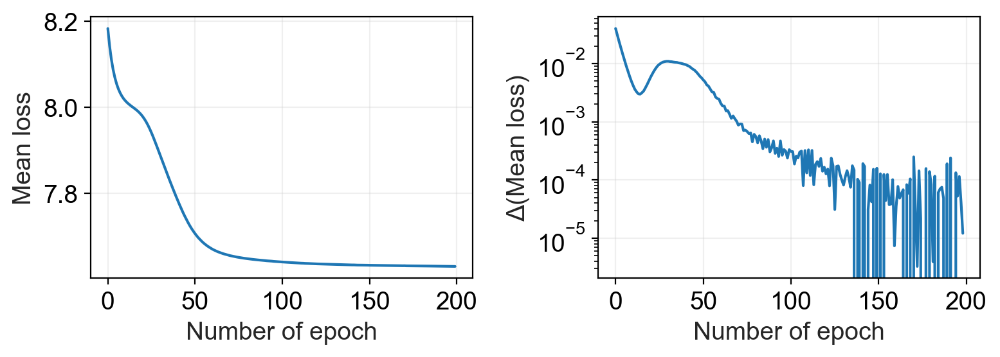

In [312]:
sl.pl.epochs_loss(clones)

In [313]:
sc.pp.neighbors(clones, use_rep="word2vec", n_neighbors=30)
sc.tl.umap(clones, min_dist=0.3)

In [314]:
clones.obs["clone_type"] = [clones_ground_truth[clone] for clone in clones.obs_names]
sc.tl.leiden(clones, resolution=0.5)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


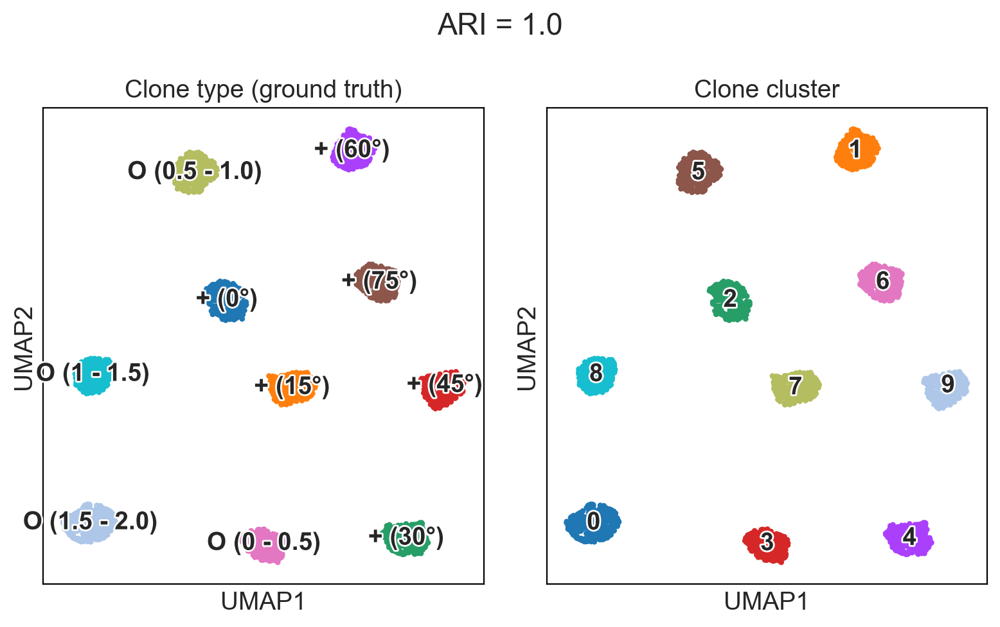

In [315]:
from sklearn.metrics import adjusted_rand_score

fig, axes = plt.subplots(ncols=2, figsize=(8, 5))
sc.pl.umap(clones, color="clone_type", title="Clone type (ground truth)", ax=axes[0], show=False, 
           legend_loc="on data", legend_fontoutline=2)
sc.pl.umap(clones, color="leiden", title="Clone cluster", ax=axes[1], show=False, 
           legend_loc="on data", legend_fontoutline=2)

fig.suptitle(f"ARI = {np.round(adjusted_rand_score(clones.obs.clone_type, clones.obs.leiden), 5)}")

fig.tight_layout()

In [316]:
from scipy.sparse import csr_matrix

adata.X = csr_matrix(adata.X)
clones.X = csr_matrix(clones.X)
clones.layers["counts"] = csr_matrix(clones.layers["counts"])
clones.layers["frequencies"] = csr_matrix(clones.layers["frequencies"])

adata.write_h5ad("05_adata.h5ad")
clones.write_h5ad("05_clones.h5ad")

In [14]:
adata = sc.read_h5ad("05_adata.h5ad")
clones = sc.read_h5ad("05_clones.h5ad")

## ... with subsampling

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


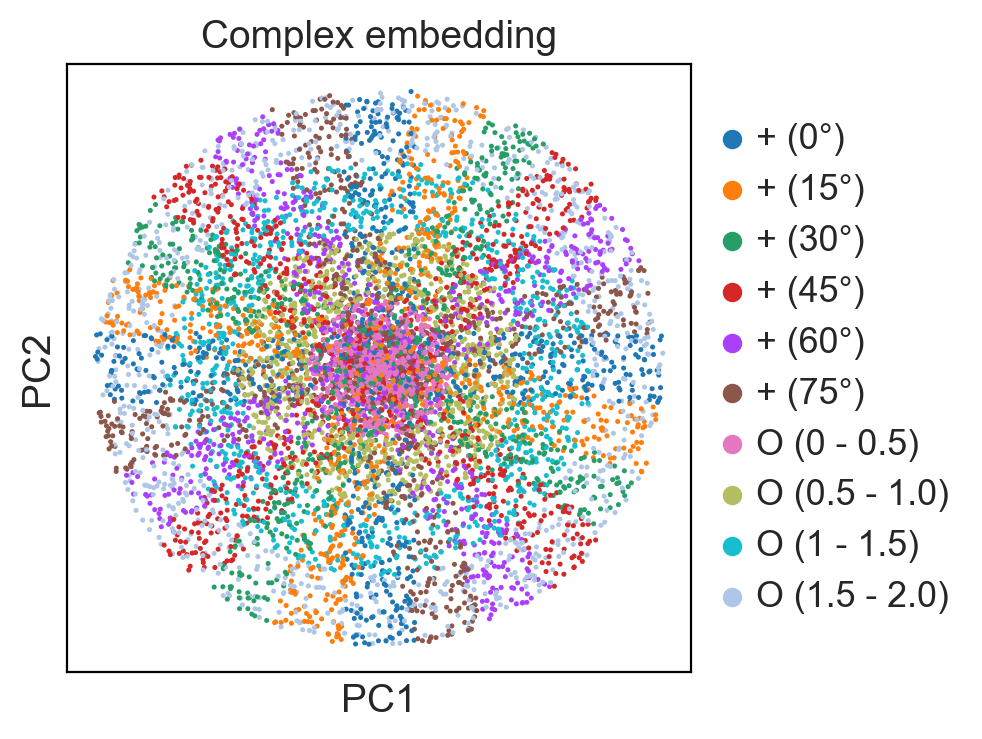

In [555]:
fraction = 0.1

adata = sc.read_h5ad("05_adata.h5ad")
adata = adata[pd.Series(adata.obs_names).sample(frac=fraction).values].copy()

sc.pl.pca(adata, color="cluster", title="Complex embedding")

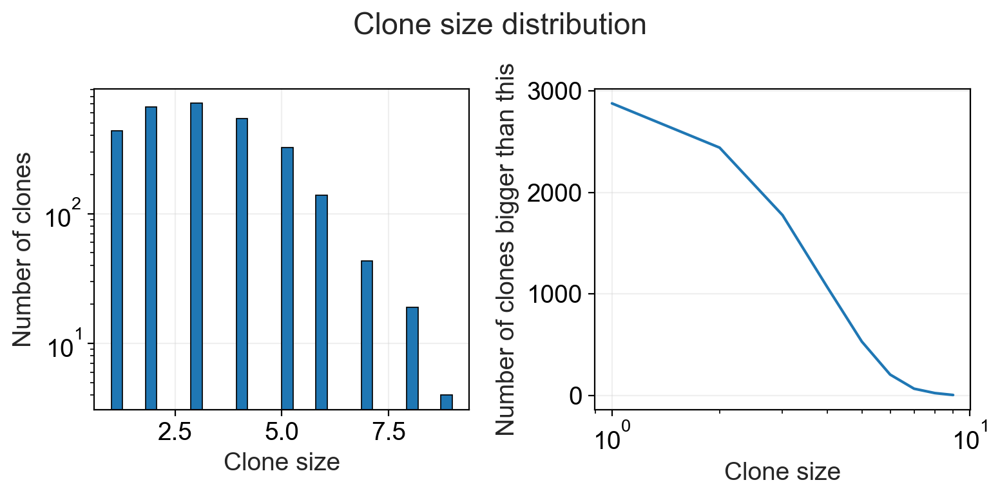

In [556]:
sl.pl.basic_stats(adata, "clone")

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


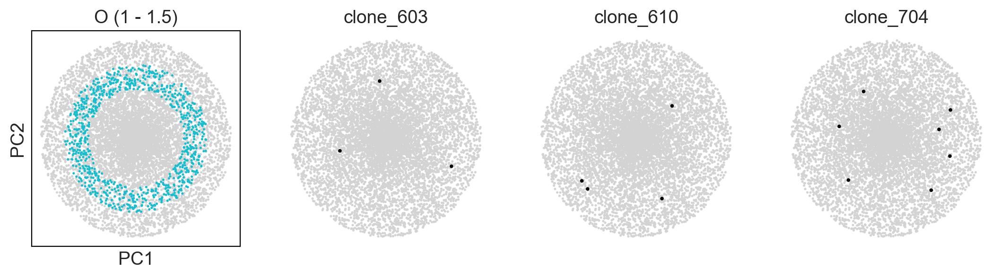

In [557]:
fig, axes = plt.subplots(ncols=4, figsize=(13, 3))

clone_1 = adata[adata.obs.cluster == "O (1 - 1.5)"].obs.clone.cat.categories[3]
clone_2 = adata[adata.obs.cluster == "O (1 - 1.5)"].obs.clone.cat.categories[10]
clone_3 = adata[adata.obs.cluster == "O (1 - 1.5)"].obs.clone.cat.categories[100]

sc.pl.pca(adata, color="cluster", title="O (1 - 1.5)", groups=["O (1 - 1.5)"], legend_loc=None, ax=axes[0], show=False)
sl.pl.clone(adata, clone_col="clone", clone_name=clone_1, basis="X_pca", ax=axes[1])
sl.pl.clone(adata, clone_col="clone", clone_name=clone_2, basis="X_pca", ax=axes[2])
sl.pl.clone(adata, clone_col="clone", clone_name=clone_3, basis="X_pca", ax=axes[3])

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


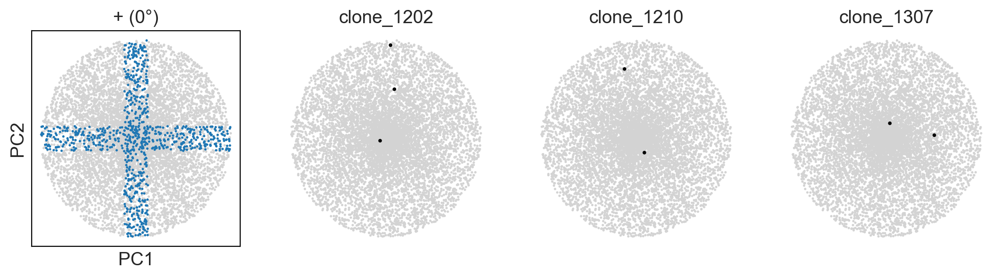

In [558]:
fig, axes = plt.subplots(ncols=4, figsize=(13, 3))

clone_1 = adata[adata.obs.cluster == "+ (0°)"].obs.clone.cat.categories[2]
clone_2 = adata[adata.obs.cluster == "+ (0°)"].obs.clone.cat.categories[10]
clone_3 = adata[adata.obs.cluster == "+ (0°)"].obs.clone.cat.categories[102]

sc.pl.pca(adata, color="cluster", title="+ (0°)", groups=["+ (0°)"], legend_loc=None, ax=axes[0], show=False)
sl.pl.clone(adata, clone_col="clone", clone_name=clone_1, basis="X_pca", ax=axes[1])
sl.pl.clone(adata, clone_col="clone", clone_name=clone_2, basis="X_pca", ax=axes[2])
sl.pl.clone(adata, clone_col="clone", clone_name=clone_3, basis="X_pca", ax=axes[3])

In [559]:
sl.tl.clonal_nn(
    adata,
    obs_name="clone",
    use_rep="X_pca",
    tqdm_bar=True,
    k=30,
    min_size=3,
)

100%|██████████| 9000/9000 [00:08<00:00, 1009.60it/s]


In [560]:
clones = sl.tl.clone2vec(
    adata,
    obs_name="clone",
    n_epochs=1500,
    z_dim=5,
    batch_size=2**16,
    device="cuda:0",
)

100%|██████████| 1500/1500 [28:57<00:00,  1.16s/it]


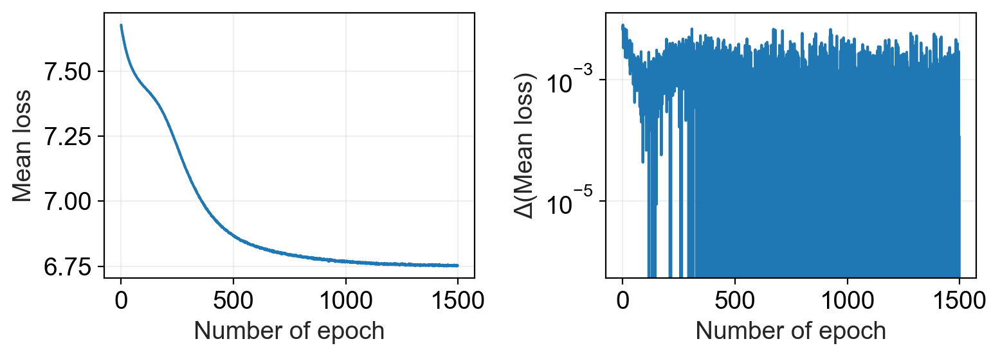

In [561]:
sl.pl.epochs_loss(clones)

In [562]:
sc.pp.neighbors(clones, use_rep="word2vec", n_neighbors=30)
sc.tl.umap(clones, min_dist=0.3)

In [565]:
ARIs = []
clones.obs["clone_type"] = [clones_ground_truth[clone] for clone in clones.obs_names]

for resolution in np.arange(0.1, 1.6, 0.1):
    sc.tl.leiden(clones, resolution=resolution)
    ARIs.append(adjusted_rand_score(clones.obs.clone_type, clones.obs.leiden))

resolution = np.arange(0.1, 1.6, 0.1)[np.argmax(ARIs)]
sc.tl.leiden(clones, resolution=resolution)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


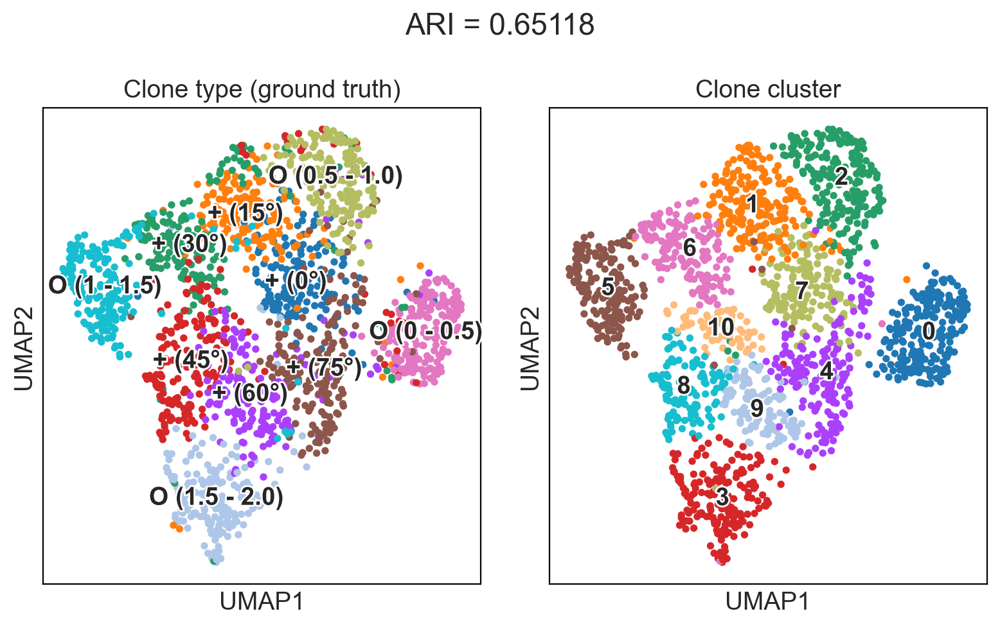

In [566]:
from sklearn.metrics import adjusted_rand_score

fig, axes = plt.subplots(ncols=2, figsize=(8, 5))
sc.pl.umap(clones, color="clone_type", title="Clone type (ground truth)", ax=axes[0], show=False, 
           legend_loc="on data", legend_fontoutline=2)
sc.pl.umap(clones, color="leiden", title="Clone cluster", ax=axes[1], show=False, 
           legend_loc="on data", legend_fontoutline=2)

fig.suptitle(f"ARI = {np.round(adjusted_rand_score(clones.obs.clone_type, clones.obs.leiden), 5)}")

fig.tight_layout()

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


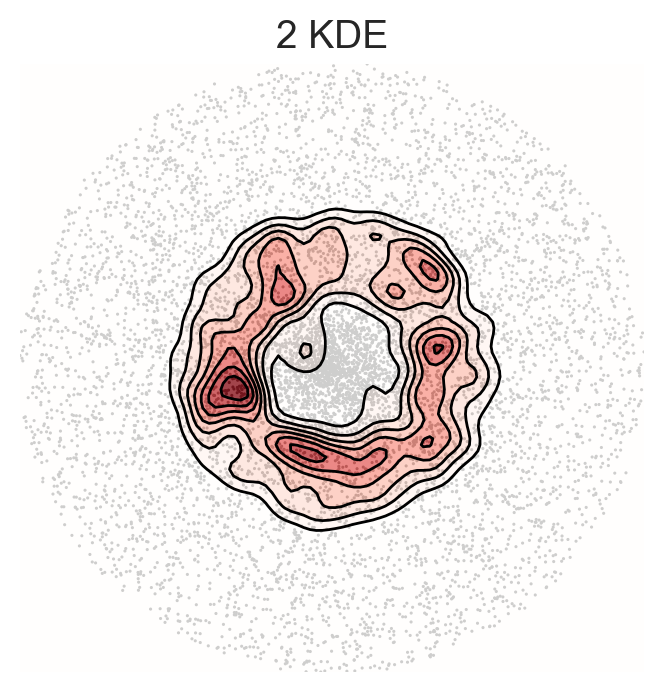

In [569]:
sl.tl.transfer_clonal_annotation(
    adata=adata,
    clones=clones,
    adata_clone_name="clone",
    adata_obs_name="clonal_cluster",
    clones_obs_name="leiden",
)

sl.pl.kde(adata, basis="X_pca", groupby="clonal_cluster", bw_method=0.15, group="2")

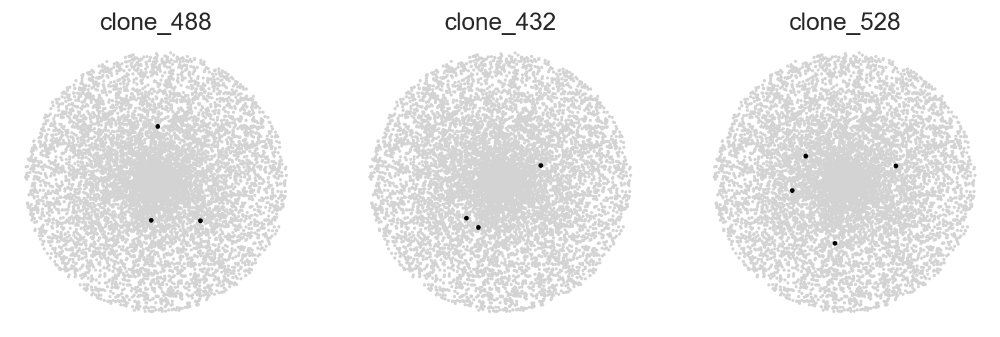

In [571]:
examples = pd.Series(list(set(
    adata[adata.obs.clonal_cluster == "2"].obs.clone
))).sample(3).values

fig, axes = plt.subplots(ncols=3, figsize=(10, 3))
for i, clone in enumerate(examples):
    sl.pl.clone(
        adata,
        clone_col="clone",
        clone_name=clone,
        ax=axes[i],
        basis="X_pca",
    )

In [572]:
from scipy.sparse import csr_matrix

adata.X = csr_matrix(adata.X)
clones.X = csr_matrix(clones.X)
clones.layers["counts"] = csr_matrix(clones.layers["counts"])
clones.layers["frequencies"] = csr_matrix(clones.layers["frequencies"])

adata.write_h5ad("06_adata.h5ad")
clones.write_h5ad("06_clones.h5ad")

## Comparison to scRNA-Seq-like approach

In [574]:
clones = sc.read_h5ad("06_clones.h5ad")
adata = sc.read_h5ad("06_adata.h5ad")

In [575]:
clones = sl.tl.refill_ct(
    adata,
    obs_name="clone",
    ct_col="leiden",
    clones=clones,
)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


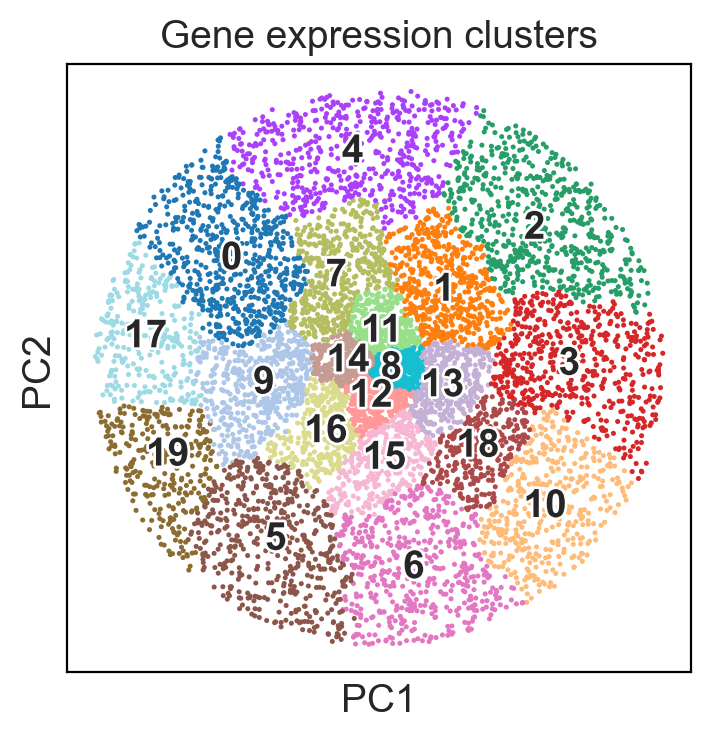

In [576]:
sc.pl.pca(adata, color="leiden", title="Gene expression clusters", legend_loc="on data", legend_fontoutline=2)

In [577]:
# scRNA-Seq-like preprocessing

sc.pp.normalize_total(clones)
sc.pp.log1p(clones)
sc.pp.pca(clones, n_comps=5)
sc.pp.neighbors(clones, use_rep="X_pca")
sc.tl.umap(clones, min_dist=0.3)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


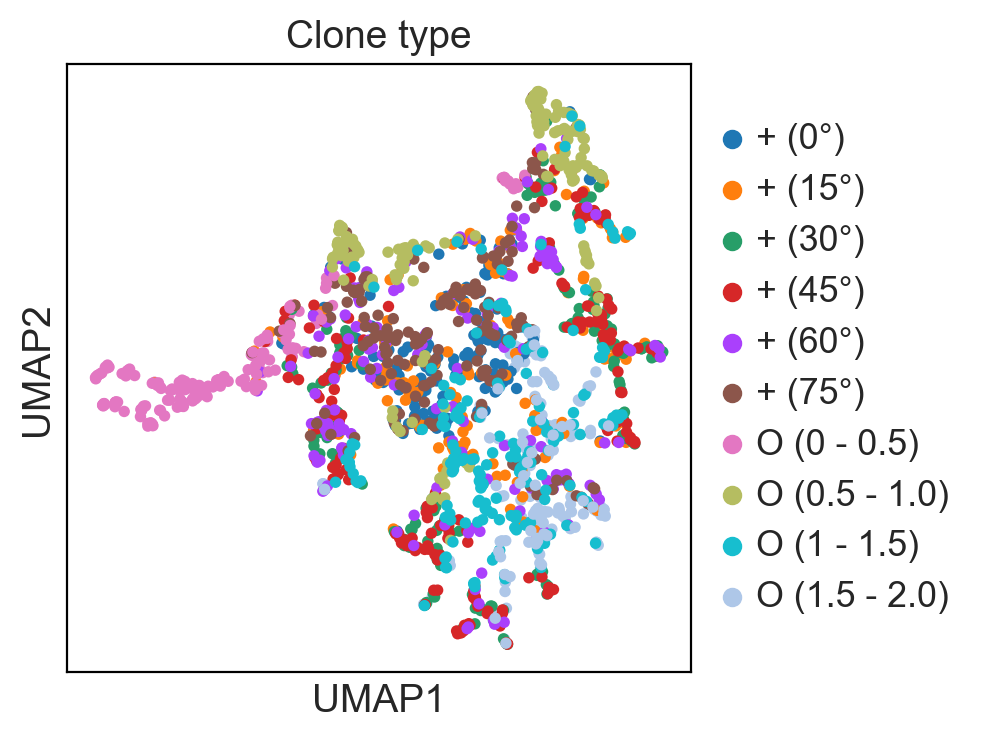

In [578]:
sc.pl.umap(clones, color="clone_type", title="Clone type")

In [579]:
ARIs = []
clones.obs["clone_type"] = [clones_ground_truth[clone] for clone in clones.obs_names]

for resolution in np.arange(0.1, 1.6, 0.1):
    sc.tl.leiden(clones, resolution=resolution)
    ARIs.append(adjusted_rand_score(clones.obs.clone_type, clones.obs.leiden))

resolution = np.arange(0.1, 1.6, 0.1)[np.argmax(ARIs)]
sc.tl.leiden(clones, resolution=resolution)

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


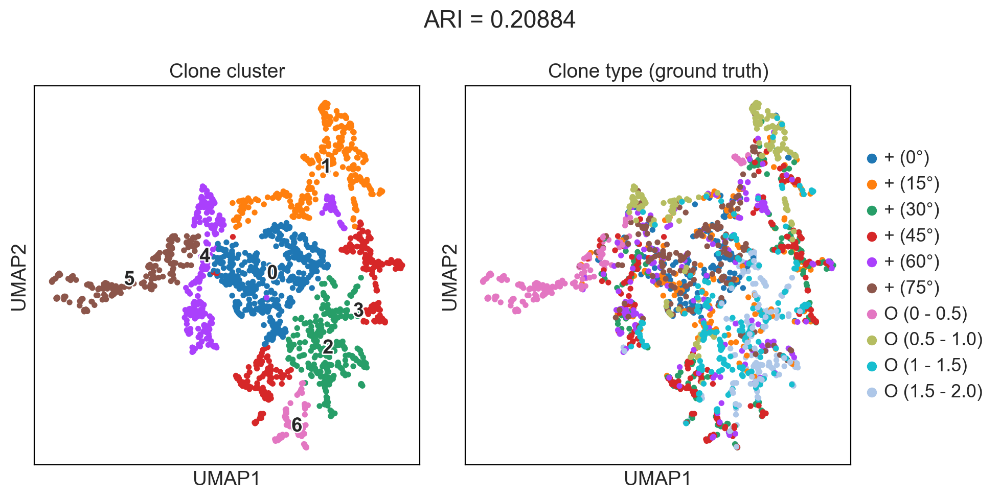

In [580]:
from sklearn.metrics import adjusted_rand_score

fig, axes = plt.subplots(ncols=2, figsize=(10, 5))
sc.pl.umap(clones, color="clone_type", title="Clone type (ground truth)", ax=axes[1], show=False)
sc.pl.umap(clones, color="leiden", title="Clone cluster", ax=axes[0], show=False, 
           legend_loc="on data", legend_fontoutline=2)

fig.suptitle(f"ARI = {np.round(adjusted_rand_score(clones.obs.clone_type, clones.obs.leiden), 5)}")

fig.tight_layout()

## Efefct of clone size

In [3]:
clones = sc.read_h5ad("06_clones.h5ad")
adata = sc.read_h5ad("06_adata.h5ad")

clones = sl.tl.refill_ct(
    adata,
    obs_name="clone",
    ct_col="cluster",
    clones=clones,
)

n_cells = clones.X.sum(axis=1)
clones.obs["n_cells"] = n_cells

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


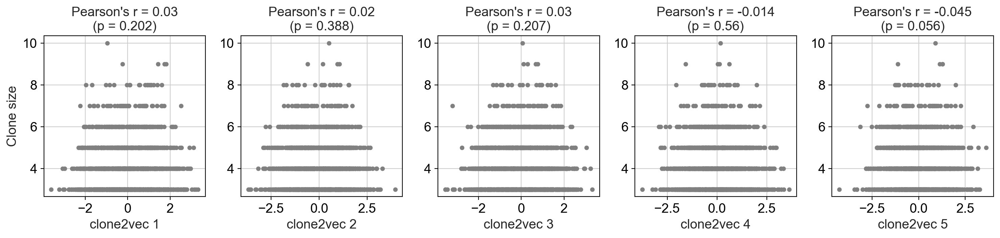

In [582]:
from scipy.stats import pearsonr
from statsmodels.stats.multitest import multipletests

fig, axes = plt.subplots(ncols=5, figsize=(15, 3.75))

ps = []
rs = []

for i in range(5):
    rs.append(np.round(pearsonr(clones.obsm["word2vec"][:, i], clones.obs["n_cells"]).statistic, 3))
    ps.append(np.round(pearsonr(clones.obsm["word2vec"][:, i], clones.obs["n_cells"]).pvalue, 3))
    
# ps = [np.round(i, 3) for i in multipletests(ps, method="fdr_bh")[1]]

for i in range(5):
    sns.scatterplot(
        x=clones.obsm["word2vec"][:, i],
        y=clones.obs["n_cells"],
        edgecolor=None,
        color="grey",
        ax=axes[i],
        s=20,
    )
    
    axes[i].set_xlabel(f"clone2vec {i + 1}")
    if i == 0:
        axes[i].set_ylabel("Clone size")
    else:
        axes[i].set_ylabel("")
    axes[i].set_title(f"Pearson's r = {rs[i]}\n(p = {ps[i]})")
        
fig.tight_layout()

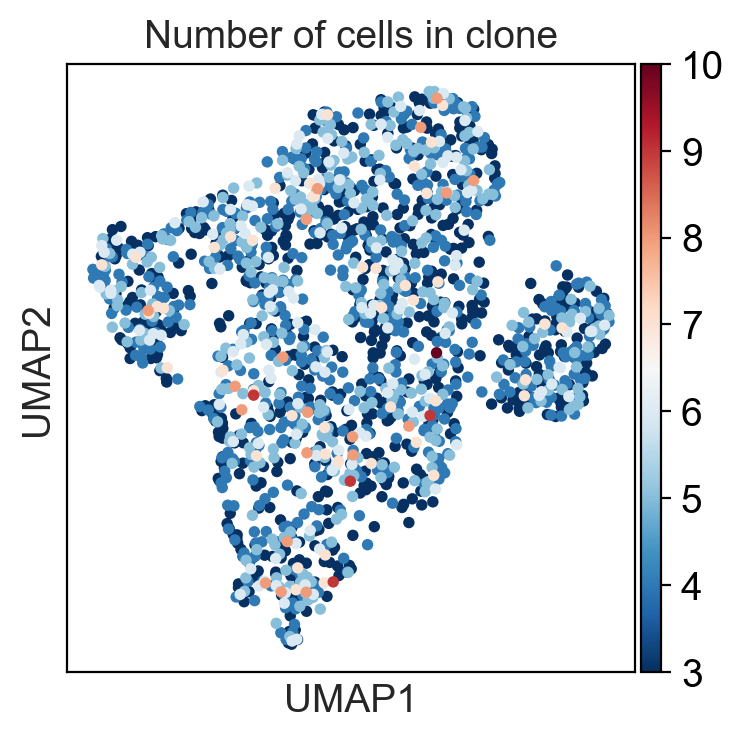

In [583]:
sc.pl.umap(
    clones,
    color="n_cells",
    cmap="RdBu_r",
    title="Number of cells in clone",
)

## Serial subsampling

In [ ]:
from sklearn.metrics import adjusted_rand_score
from scipy.sparse import csr_matrix
from tqdm import tqdm

fractions = [0.01, 0.05, 0.1, 0.25, 0.5]
final_metrics = {}

for fraction in tqdm(fractions):
    adata = sc.read_h5ad("05_adata.h5ad")
    final_metrics[fraction] = []
    subsamples = [pd.Series(adata.obs_names).sample(frac=fraction).values.copy() for i in range(10)]
    for i in range(5):
        adata = sc.read_h5ad("05_adata.h5ad")
        adata = adata[subsamples[i]].copy()
        
        sl.tl.clonal_nn(adata, obs_name="clone", use_rep="X_pca", tqdm_bar=False, k=30, min_size=2)
        clones = sl.tl.clone2vec(adata, obs_name="clone", n_epochs=250, z_dim=5, device="cuda:0", tqdm_bar=False)
        
        sc.pp.neighbors(clones, use_rep="word2vec", n_neighbors=30)
        sc.tl.umap(clones, min_dist=0.3)
        
        clones.obs["clone_type"] = [clones_ground_truth[clone] for clone in clones.obs_names]
        ARIs = []
        
        for resolution in np.arange(0.1, 1.6, 0.1):
            sc.tl.leiden(clones, resolution=resolution)
            ARIs.append(adjusted_rand_score(clones.obs.clone_type, clones.obs.leiden))
            
        resolution = np.arange(0.1, 1.6, 0.1)[np.argmax(ARIs)]
        sc.tl.leiden(clones, resolution=resolution)
        
        final_metrics[fraction].append(max(ARIs))

        adata.X = csr_matrix(adata.X)
        clones.X = csr_matrix(clones.X)
        clones.layers["counts"] = csr_matrix(clones.layers["counts"])
        clones.layers["frequencies"] = csr_matrix(clones.layers["frequencies"])
        
        adata.write_h5ad(f"07_Serial_subsampling/adata_{fraction}_{i}.h5ad")
        clones.write_h5ad(f"07_Serial_subsampling/clones_{fraction}_{i}.h5ad")
        
final_metrics = pd.DataFrame(final_metrics).unstack().reset_index()[["level_0", 0]]
final_metrics.columns = ["fraction", "ARI"]
final_metrics = pd.concat([final_metrics, pd.DataFrame({"fraction": [1], "ARI": [1]})]).reset_index(drop=True)
mean_metrics = final_metrics.groupby("fraction").mean().reset_index()

 50%|█████     | 3/6 [3:47:03<4:41:09, 5623.20s/it]

(-0.05, 1.05)

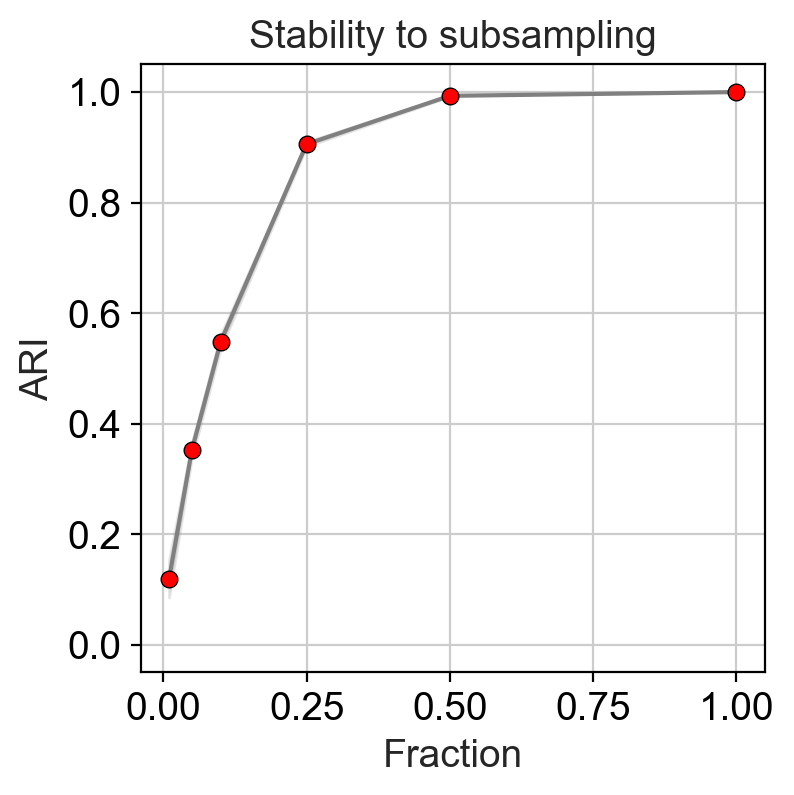

In [655]:
fig, ax = plt.subplots(figsize=(4, 4))
sns.lineplot(
    x="fraction",
    y="ARI",
    data=final_metrics,
    ax=ax,
    color="grey",
)
sns.scatterplot(
    x="fraction",
    y="ARI",
    data=mean_metrics,
    ax=ax,
    zorder=100,
    color="red",
    edgecolor="black",
)
ax.set_xlabel("Fraction")
ax.set_title("Stability to subsampling")
ax.set_ylim(-0.05, 1.05)

In [659]:
adatas = {1: sc.read_h5ad("05_adata.h5ad")}
clones = {1: sc.read_h5ad("05_clones.h5ad")}

for frac in fractions:
    adatas[frac] = sc.read_h5ad(f"07_Serial_subsampling/adata_{frac}_0.h5ad")
    clones[frac] = sc.read_h5ad(f"07_Serial_subsampling/clones_{frac}_0.h5ad")

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided 

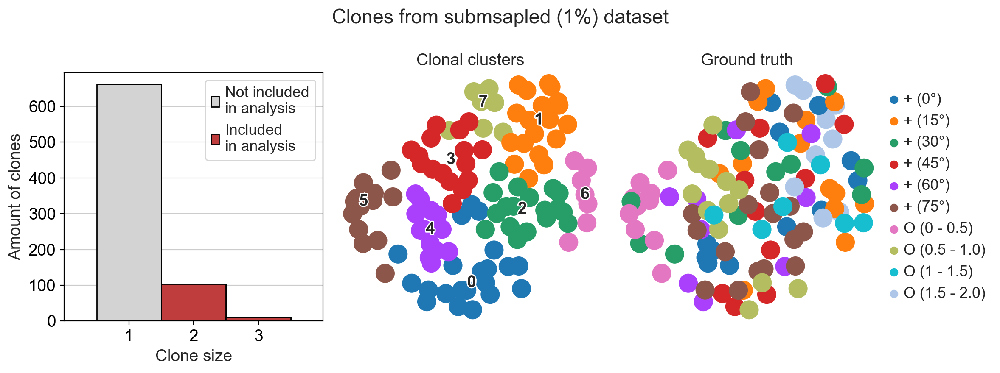

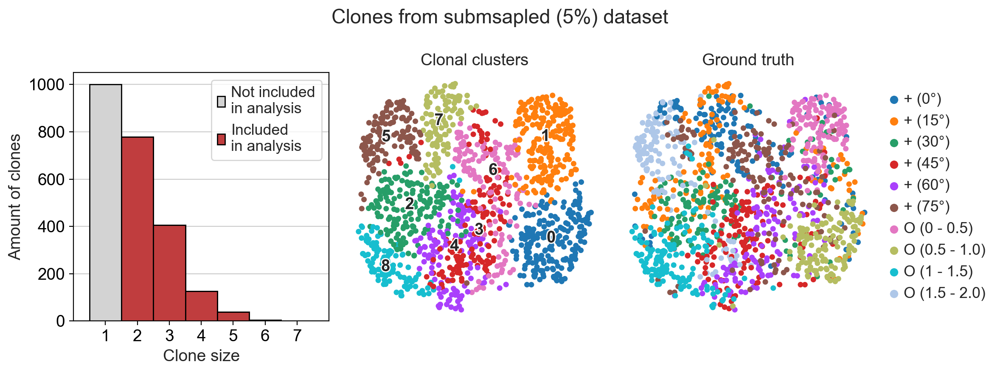

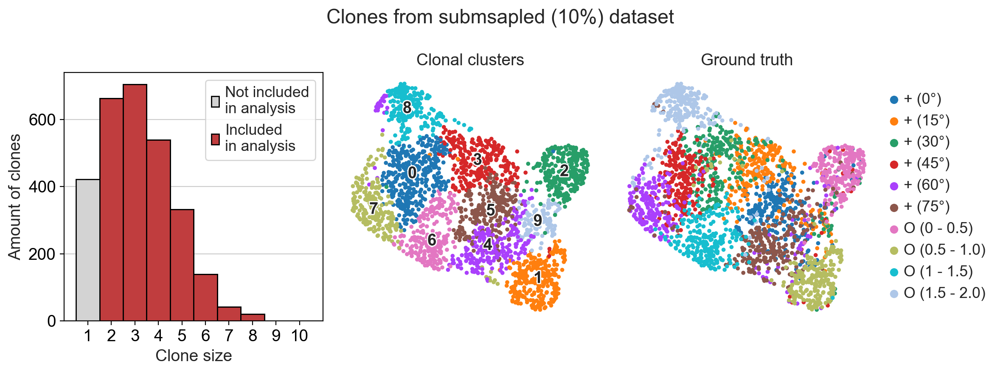

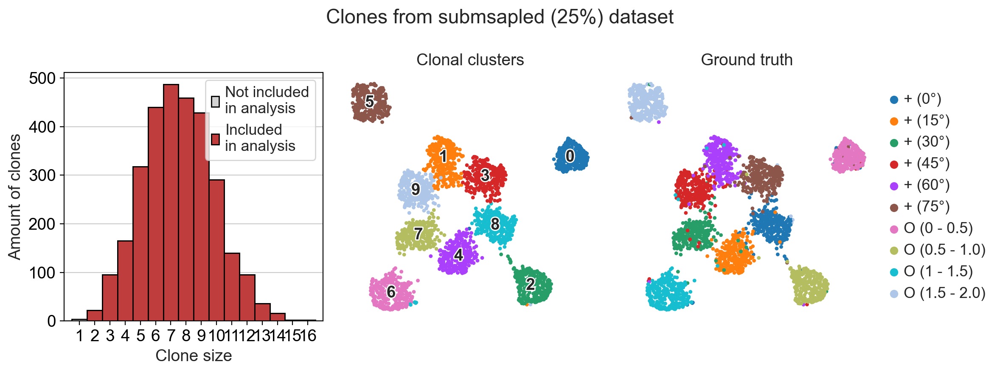

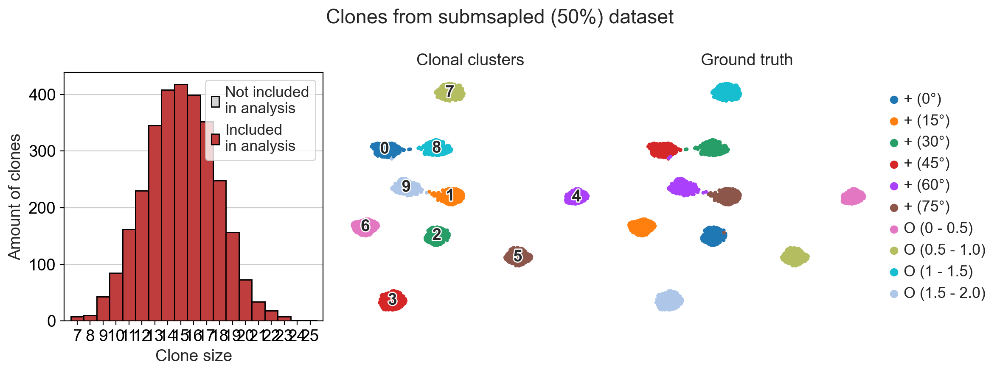

In [789]:
for frac in list(fractions):
    fig, axes = plt.subplots(ncols=3, figsize=(12, 4.5))
    labels, counts = np.unique(adatas[frac].obs["clone"].value_counts().values, return_counts=True)
    sns.barplot(x=labels, y=counts, edgecolor="black", width=1, color="lightgrey", ax=axes[0], label="Not included\nin analysis")
    sns.barplot(x=labels[labels > 1], y=counts[labels > 1], edgecolor="black", width=1, color=sns.color_palette()[3],
                ax=axes[0], label="Included\nin analysis")

    axes[0].set_xlabel("Clone size")
    axes[0].set_ylabel("Amount of clones")
    axes[0].legend()
    axes[0].set_xlim(-1, len(labels))

    sc.pl.umap(clones[frac], color="leiden", frameon=False, legend_loc="on data", legend_fontoutline=2, title="Clonal clusters", ax=axes[1], show=False)
    sc.pl.umap(clones[frac], color="clone_type", frameon=False, title="Ground truth", ax=axes[2], show=False)

    fig.suptitle(f"Clones from submsapled ({int(frac * 100)}%) dataset")
    fig.tight_layout()

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided 

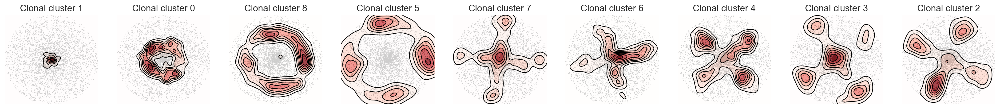

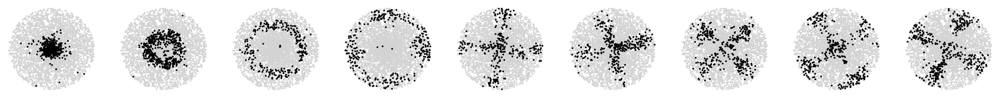

In [772]:
sl.tl.transfer_clonal_annotation(
    adata=adatas[0.05],
    clones=clones[0.05],
    adata_clone_name="clone",
    adata_obs_name="clonal_cluster",
    clones_obs_name="leiden",
)

fig, axes = plt.subplots(ncols=9, figsize=(27, 2.5))
for i, j in enumerate([1, 0, 8, 5, 7, 6, 4, 3, 2]):
    sl.pl.kde(
        adatas[0.05],
        basis="X_pca",
        groupby="clonal_cluster",
        bw_method=0.2,
        group=str(j),
        ax=axes[i],
        title=f"Clonal cluster {j}",
    )
    
fig, axes = plt.subplots(ncols=9, figsize=(27, 2.5))
for i, j in enumerate([1, 0, 8, 5, 7, 6, 4, 3, 2]):
    sl.pl.clone(
        adatas[0.05],
        basis="X_pca",
        clone_col="clonal_cluster",
        clone_name=str(j),
        ax=axes[i],
        title="",
    )

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


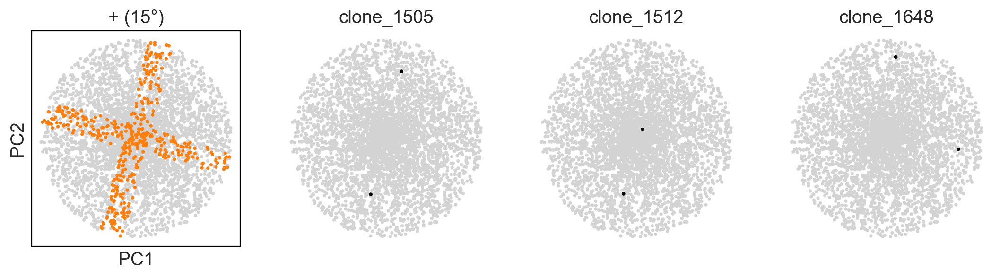

In [785]:
fig, axes = plt.subplots(ncols=4, figsize=(13, 3))

group = "+ (15°)"

clone_1 = adatas[0.05][adatas[0.05].obs.cluster == group].obs.clone.cat.categories[3]
clone_2 = adatas[0.05][adatas[0.05].obs.cluster == group].obs.clone.cat.categories[10]
clone_3 = adatas[0.05][adatas[0.05].obs.cluster == group].obs.clone.cat.categories[112]

sc.pl.pca(adatas[0.05], color="cluster", title=group, groups=[group], legend_loc=None, ax=axes[0], show=False)
sl.pl.clone(adatas[0.05], clone_col="clone", clone_name=clone_1, basis="X_pca", ax=axes[1])
sl.pl.clone(adatas[0.05], clone_col="clone", clone_name=clone_2, basis="X_pca", ax=axes[2])
sl.pl.clone(adatas[0.05], clone_col="clone", clone_name=clone_3, basis="X_pca", ax=axes[3])

In [799]:
fractions = [0.01, 0.05, 0.1, 0.25, 0.5]
PCA_metrics = {}

for fraction in fractions:
    PCA_metrics[fraction] = []
    for i in range(5):
        adata = sc.read_h5ad(f"07_Serial_subsampling/adata_{fraction}_{i}.h5ad")
        clones = sc.read_h5ad(f"07_Serial_subsampling/clones_{fraction}_{i}.h5ad")
        
        clones = sl.tl.refill_ct(
            adata,
            obs_name="clone",
            ct_col="leiden",
            clones=clones,
        )

        sc.pp.normalize_total(clones)
        sc.pp.log1p(clones)
        sc.pp.pca(clones, n_comps=5)
        sc.pp.neighbors(clones, use_rep="X_pca")
        
        ARIs = []
        
        for resolution in np.arange(0.1, 1.6, 0.1):
            sc.tl.leiden(clones, resolution=resolution)
            ARIs.append(adjusted_rand_score(clones.obs.clone_type, clones.obs.leiden))
            
        resolution = np.arange(0.1, 1.6, 0.1)[np.argmax(ARIs)]
        sc.tl.leiden(clones, resolution=resolution)
        
        PCA_metrics[fraction].append(max(ARIs))

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationW

In [803]:
adata = sc.read_h5ad("05_adata.h5ad")
clones = sc.read_h5ad("05_clones.h5ad")

clones = sl.tl.refill_ct(
    adata,
    obs_name="clone",
    ct_col="leiden",
    clones=clones,
)

sc.pp.normalize_total(clones)
sc.pp.log1p(clones)
sc.pp.pca(clones, n_comps=5)
sc.pp.neighbors(clones, use_rep="X_pca")

ARIs = []

for resolution in np.arange(0.1, 1.6, 0.1):
    sc.tl.leiden(clones, resolution=resolution)
    ARIs.append(adjusted_rand_score(clones.obs.clone_type, clones.obs.leiden))

resolution = np.arange(0.1, 1.6, 0.1)[np.argmax(ARIs)]
sc.tl.leiden(clones, resolution=resolution)

PCA_metrics[1] = [max(ARIs)] * 5

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [804]:
PCA_metrics = pd.DataFrame(PCA_metrics).unstack().reset_index()[["level_0", 0]]
PCA_metrics.columns = ["fraction", "ARI"]
mean_PCA_metrics = PCA_metrics.groupby("fraction").mean().reset_index()

(-0.05, 1.05)

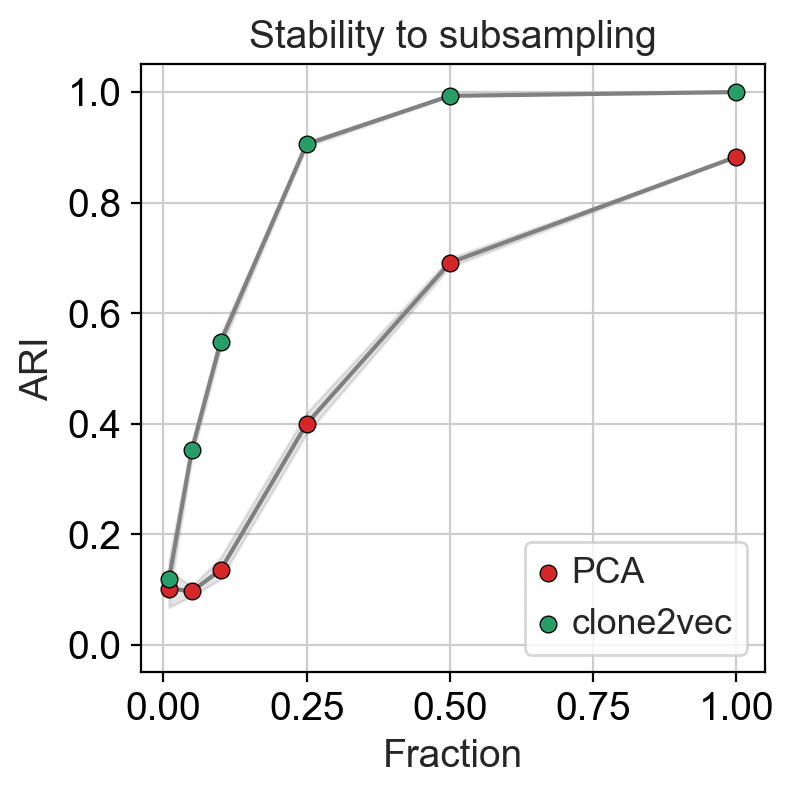

In [813]:
fig, ax = plt.subplots(figsize=(4, 4))
sns.lineplot(
    x="fraction",
    y="ARI",
    data=PCA_metrics,
    ax=ax,
    color="grey",
)
sns.scatterplot(
    x="fraction",
    y="ARI",
    data=mean_PCA_metrics,
    ax=ax,
    zorder=100,
    color=sns.color_palette()[3],
    edgecolor="black",
    label="PCA",
)
sns.lineplot(
    x="fraction",
    y="ARI",
    data=final_metrics,
    ax=ax,
    color="grey",
)
sns.scatterplot(
    x="fraction",
    y="ARI",
    data=mean_metrics,
    ax=ax,
    zorder=100,
    color=sns.color_palette()[2],
    edgecolor="black",
    label="clone2vec",
)
ax.set_xlabel("Fraction")
ax.set_title("Stability to subsampling")
ax.set_ylim(-0.05, 1.05)

## Comparison to GLM-PCA

In [ ]:
from scipy.sparse import csr_matrix
from glmpca import glmpca
from tqdm import tqdm

fractions = [0.01, 0.05, 0.1, 0.25, 0.5]
replicates = [0, 1, 2, 3, 4]

for fraction in fractions:
    for replicate in tqdm(replicates):
        adata = sc.read_h5ad(f"07_Serial_subsampling/adata_{fraction}_{replicate}.h5ad")
        clones = sc.read_h5ad(f"07_Serial_subsampling/clones_{fraction}_{replicate}.h5ad")

        # Calculating GLM-PCA
        clones_glmpca = pd.DataFrame(
            adata.obsm["bag-of-clones"].A
        ).groupby(adata.obs.clone.values).sum()
        clones_glmpca.columns = adata.uns["bag-of-clones_names"]
        clones_glmpca = clones_glmpca.loc[clones_glmpca.columns]
        clones_glmpca = sc.AnnData(clones_glmpca)
        clones_glmpca.X = csr_matrix(clones_glmpca.X)
        clones_glmpca = clones_glmpca[clones.obs_names].copy()
        glmpoi = glmpca.glmpca(Y=clones_glmpca.X.A.T, L=5, fam="poi")
        glmmult = glmpca.glmpca(Y=clones_glmpca.X.A.T, L=5, fam="mult")

        # Saving the results
        clones.obsm["X_poi_pca"] = glmpoi["factors"].copy()
        clones.obsm["X_mult_pca"] = glmmult["factors"].copy()
        clones.write_h5ad(f"07_Serial_subsampling/clones_{fraction}_{replicate}.h5ad")

  0%|          | 0/5 [00:00<?, ?it/s]/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
 20%|██        | 1/5 [00:01<00:04,  1.17s/it]/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
 40%|████      | 2/5 [00:02<00:03,  1.11s/it]/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
 60%|██████    | 3/5 [00:02<00:01,  1.06it/s]/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn

In [589]:
from sklearn.metrics import adjusted_rand_score

fractions = [0.01, 0.05, 0.1, 0.25, 0.5]
replicates = [0, 1, 2, 3, 4]

for fraction in fractions:
    for replicate in tqdm(replicates):
        clones = sc.read_h5ad(f"07_Serial_subsampling/clones_{fraction}_{replicate}.h5ad")
        for emb in ["X_poi_pca", "X_mult_pca", "word2vec"]:
            sc.pp.neighbors(clones, use_rep=emb, n_neighbors=30)
            sc.tl.umap(clones, min_dist=0.3)

            ARIs = []

            for resolution in np.arange(0.1, 1.6, 0.1):
                sc.tl.leiden(clones, resolution=resolution)
                ARIs.append(adjusted_rand_score(clones.obs.clone_type, clones.obs.leiden))

            resolution = np.arange(0.1, 1.6, 0.1)[np.argmax(ARIs)]
            del clones.obs["leiden"]
            sc.tl.leiden(clones, resolution=resolution, key_added=f"leiden_{emb}")

            clones.uns[f"ARI_{emb}"] = max(ARIs)
        clones.write_h5ad(f"07_Serial_subsampling/clones_{fraction}_{replicate}.h5ad")

100%|██████████| 5/5 [05:08<00:00, 61.79s/it]


In [590]:
final_metrics = {
    "replicate": [],
    "fraction": [],
    "method": [],
    "ARI": [],
}

for fraction in fractions:
    for replicate in tqdm(replicates):
        clones = sc.read_h5ad(f"07_Serial_subsampling/clones_{fraction}_{replicate}.h5ad")
        
        final_metrics["replicate"] += [replicate] * 3
        final_metrics["fraction"] += [fraction] * 3
        final_metrics["ARI"] += [
            clones.uns[f"ARI_word2vec"],
            clones.uns[f"ARI_X_mult_pca"],
            clones.uns[f"ARI_X_poi_pca"],
        ]
        final_metrics["method"] += ["clone2vec", "mult-pca", "poi-pca"]
        
final_metrics = pd.DataFrame(final_metrics)

100%|██████████| 5/5 [00:00<00:00, 21.26it/s]


In [599]:
for fraction in fractions:
    for replicate in tqdm(replicates):
        clones = sc.read_h5ad(f"07_Serial_subsampling/clones_{fraction}_{replicate}.h5ad")
        for emb in ["X_poi_pca", "X_mult_pca", "word2vec"]:
            sc.pp.neighbors(clones, use_rep=emb, n_neighbors=30)
            sc.tl.umap(clones, min_dist=0.3)
            clones.obsm[f"X_umap_{emb}"] = clones.obsm["X_umap"].copy()
        clones.write_h5ad(f"07_Serial_subsampling/clones_{fraction}_{replicate}.h5ad")

100%|██████████| 5/5 [02:16<00:00, 27.27s/it]


/tmp/ipykernel_14737/4243490022.py:13: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  data=final_metrics[final_metrics.method == "clone2vec"].groupby("fraction").mean().reset_index(),
/tmp/ipykernel_14737/4243490022.py:31: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  data=final_metrics[final_metrics.method == "mult-pca"].groupby("fraction").mean().reset_index(),
/tmp/ipykernel_14737/4243490022.py:49: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should 

(-0.05, 1.05)

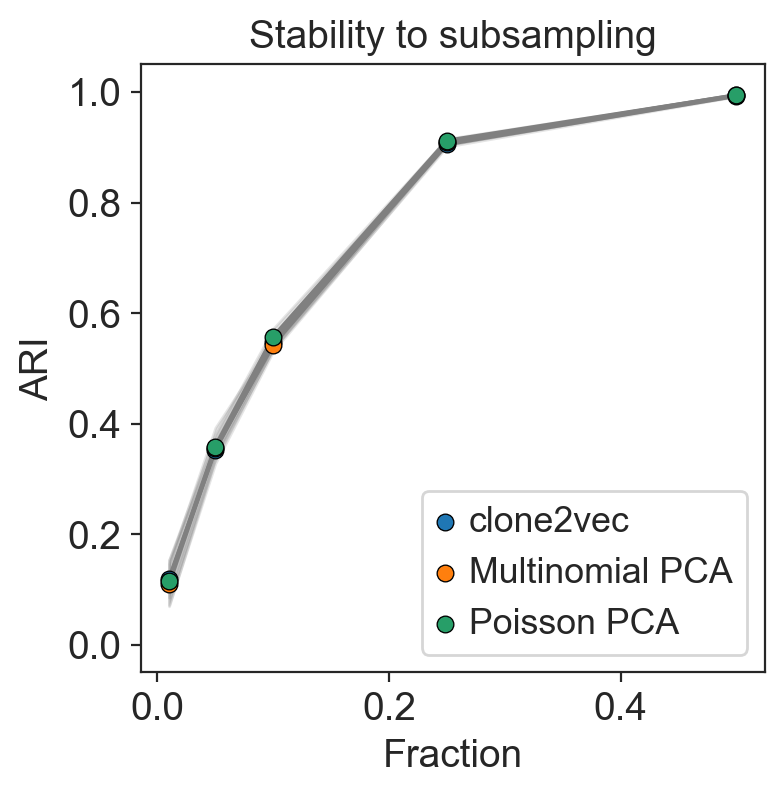

In [598]:
fig, ax = plt.subplots(figsize=(4, 4))

sns.lineplot(
    x="fraction",
    y="ARI",
    data=final_metrics[final_metrics.method == "clone2vec"],
    ax=ax,
    color="grey",
)
sns.scatterplot(
    x="fraction",
    y="ARI",
    data=final_metrics[final_metrics.method == "clone2vec"].groupby("fraction").mean().reset_index(),
    ax=ax,
    zorder=100,
    color=sns.color_palette()[0],
    edgecolor="black",
    label="clone2vec",
)

sns.lineplot(
    x="fraction",
    y="ARI",
    data=final_metrics[final_metrics.method == "mult-pca"],
    ax=ax,
    color="grey",
)
sns.scatterplot(
    x="fraction",
    y="ARI",
    data=final_metrics[final_metrics.method == "mult-pca"].groupby("fraction").mean().reset_index(),
    ax=ax,
    zorder=100,
    color=sns.color_palette()[1],
    edgecolor="black",
    label="Multinomial PCA",
)

sns.lineplot(
    x="fraction",
    y="ARI",
    data=final_metrics[final_metrics.method == "poi-pca"],
    ax=ax,
    color="grey",
)
sns.scatterplot(
    x="fraction",
    y="ARI",
    data=final_metrics[final_metrics.method == "poi-pca"].groupby("fraction").mean().reset_index(),
    ax=ax,
    zorder=100,
    color=sns.color_palette()[2],
    edgecolor="black",
    label="Poisson PCA",
)

ax.set_xlabel("Fraction")
ax.set_title("Stability to subsampling")
ax.set_ylim(-0.05, 1.05)

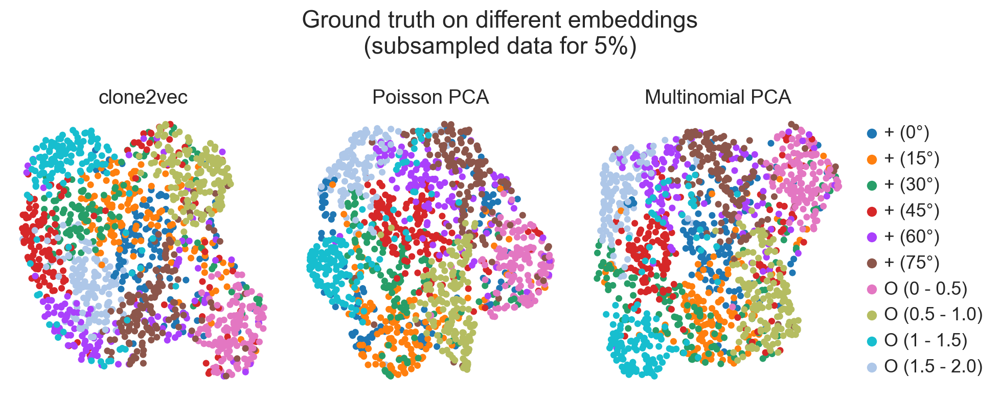

In [607]:
fraction = 0.05
replicate = 4

clones = sc.read_h5ad(f"07_Serial_subsampling/clones_{fraction}_{replicate}.h5ad")

fig, axes = plt.subplots(ncols=3, figsize=(10, 4))

sc.pl.embedding(clones, basis="X_umap_word2vec", ax=axes[0], show=False,
                color="clone_type", legend_loc=None, title="clone2vec", frameon=False)
sc.pl.embedding(clones, basis="X_umap_X_poi_pca", ax=axes[1], show=False,
                color="clone_type", legend_loc=None, title="Poisson PCA", frameon=False)
sc.pl.embedding(clones, basis="X_umap_X_mult_pca", ax=axes[2], show=False,
                color="clone_type", title="Multinomial PCA", frameon=False)

fig.suptitle("Ground truth on different embeddings\n(subsampled data for 5%)")
fig.tight_layout()

In [724]:
adata = sc.read_h5ad("07_Serial_subsampling/adata_0.1_2.h5ad")
clones = sc.read_h5ad("07_Serial_subsampling/clones_0.1_2.h5ad")

sl.tl.transfer_clonal_annotation(adata, clones, "clone", "clones_leiden", "leiden_word2vec")

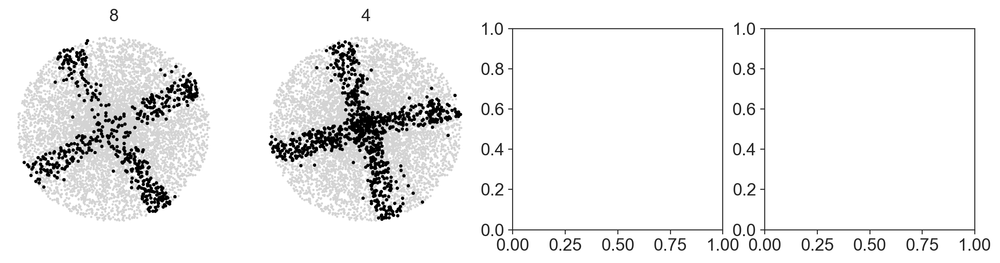

In [747]:
fig, axes = plt.subplots(ncols=4, figsize=(14, 3))

for i, clone in enumerate(["7", "9", "6", "2"]):
    sl.pl.clone(adata, "clones_leiden", clone, basis="X_pca", ax=axes[i])

In [723]:
adata

AnnData object with n_obs × n_vars = 9000 × 1
    obs: 'clone', 'cluster', 'leiden', 'clones_leiden'
    uns: 'bag-of-clones_names', 'cluster_colors', 'leiden', 'leiden_colors', 'neighbors'
    obsm: 'X_pca', 'bag-of-clones'
    obsp: 'connectivities', 'distances'

<Axes: xlabel='X_umap_word2vec1', ylabel='X_umap_word2vec2'>

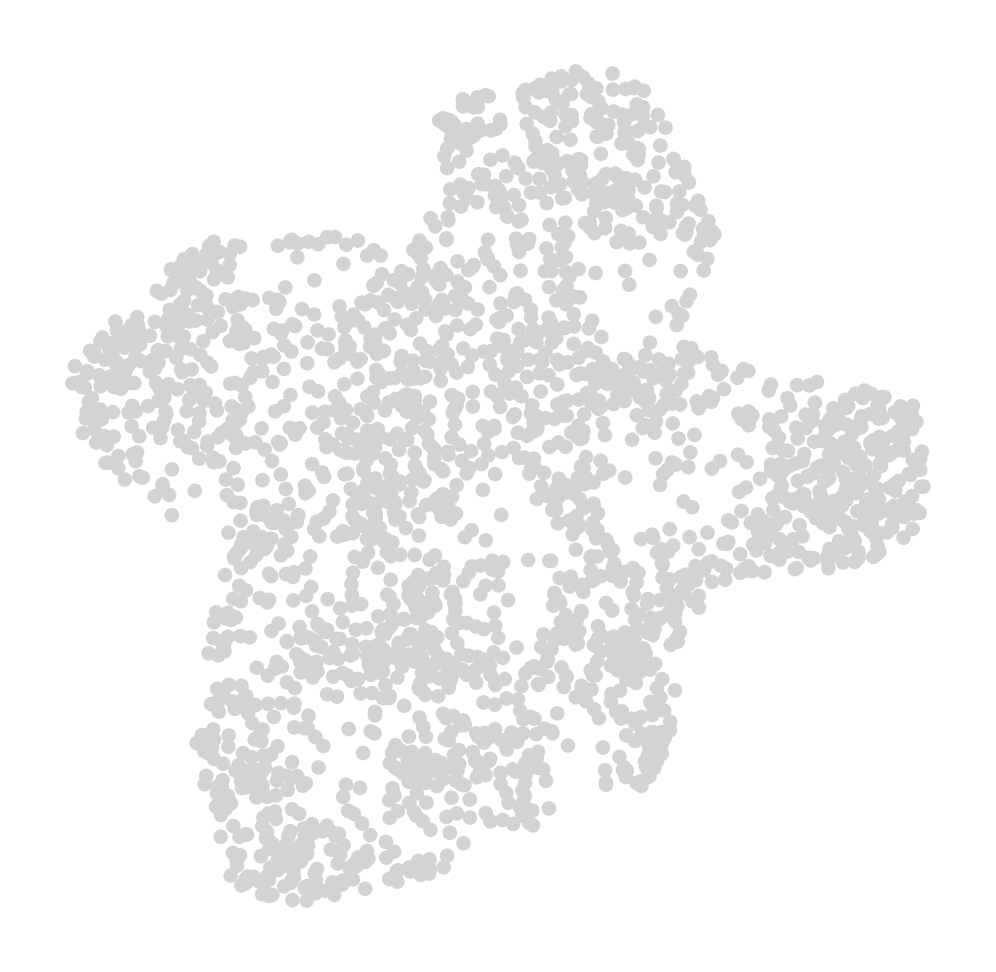

In [749]:
fig, ax = plt.subplots(figsize=(4, 4), dpi=150)

sc.pl.embedding(
    clones,
    #color="leiden_word2vec",
    basis="X_umap_word2vec",
    frameon=False,
    ax=ax,
    show=False,
    legend_loc="on data",
    legend_fontoutline=3,
    title="",
    groups=["7", "9", "6", "2", "8", "4"],
    na_in_legend=False,
)

## Vector properties on simulated data

In [750]:
generate_coordinates = {
    "A": lambda x: np.array([
        np.random.normal(0, size=x),
        np.random.normal(0, size=x),
    ]).T,
    "B": lambda x: np.array([
        np.random.normal(10, size=x),
        np.random.normal(10, size=x),
    ]).T,
    "C": lambda x: np.array([
        np.random.normal(10, size=x),
        np.random.normal(0, size=x),
    ]).T,
}

def create_clone(groups, size=3):
    return np.concatenate([
        generate_coordinates[group](size) for group in groups
    ])

In [3]:
coordinates = []
labels = []
ps = []
clones_ground_truth = {}
cells_labels = []

clone_types = [
    "AAAAAA", "BBBBBB", "CCCCCC",
    "AAABBB", "AAACCC", "BBBCCC",
    "AABBCC",
]

clone_number = 0
for clone_type in clone_types:
    for i in range(50):
        clone_name = f"clone_{clone_number}"
        clones_ground_truth[clone_name] = clone_type
        coordinates += list(create_clone(clone_type))
        labels += [clone_name] * 18
        ps += [clone_type] * 18
        clone_number += 1
        for fate in clone_type:
            cells_labels += [fate] * 3
        
coordinates = np.array(coordinates)

In [452]:
sc.settings.figdir = "figures_geometry"

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


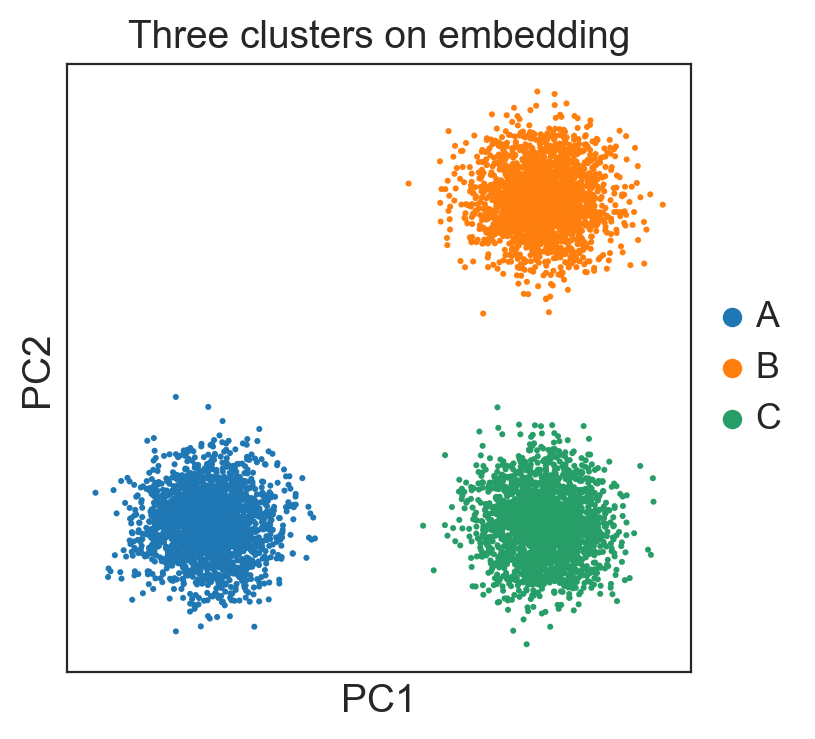

In [454]:
n_cells = coordinates.shape[0]

adata = sc.AnnData(
    X=np.matrix([[0] * n_cells]).T,
    obsm={"X_pca": coordinates},
    obs=pd.DataFrame({
        "clone": labels,
        "clone_type": ps,
        "cluster": cells_labels,
    })
)

sc.pl.pca(adata, color="cluster", title="Three clusters on embedding",
          save="PCA.pdf")

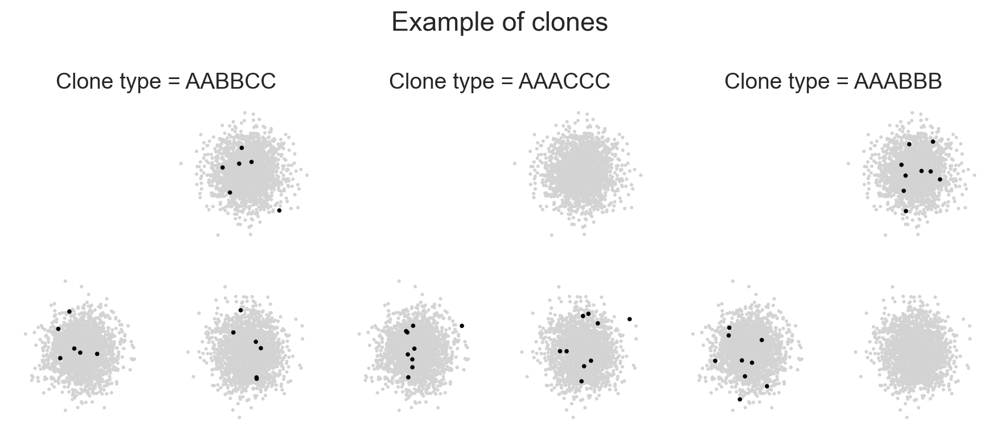

In [455]:
fig, axes = plt.subplots(ncols=3, figsize=(9, 4))
for i, clone_type in enumerate(["AABBCC", "AAACCC", "AAABBB"]):
    clone = adata[adata.obs.clone_type == clone_type].obs.clone[0]
    sl.pl.clone(adata, "clone", clone, basis="X_pca", ax=axes[i], title=f"Clone type = {clone_type}")
    
fig.suptitle("Example of clones")
fig.tight_layout()

plt.savefig("figures_geometry/clones_examples.pdf", bbox_inches="tight")

In [467]:
sl.tl.clonal_nn(
    adata,
    obs_name="clone",
    use_rep="X_pca",
    tqdm_bar=True,
    k=10,
)

100%|██████████| 6300/6300 [00:06<00:00, 1047.23it/s]


In [468]:
clones = sl.tl.clone2vec(
    adata,
    obs_name="clone",
    n_epochs=100,
    z_dim=2,
    device="cuda:0",
)

100%|██████████| 100/100 [02:52<00:00,  1.73s/it]


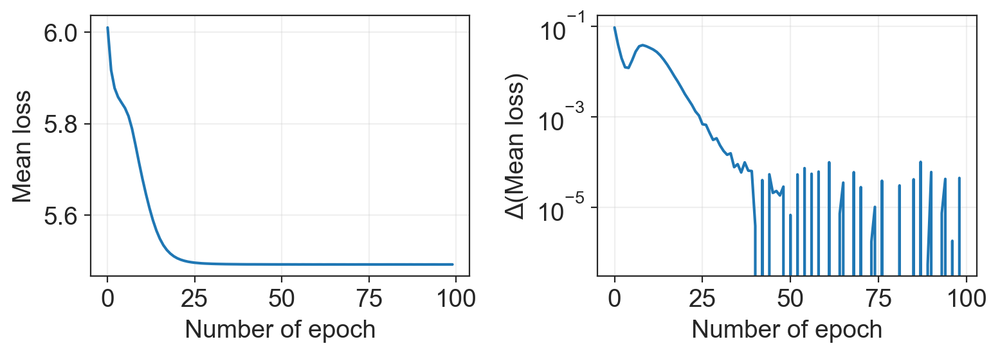

In [469]:
sl.pl.epochs_loss(clones)

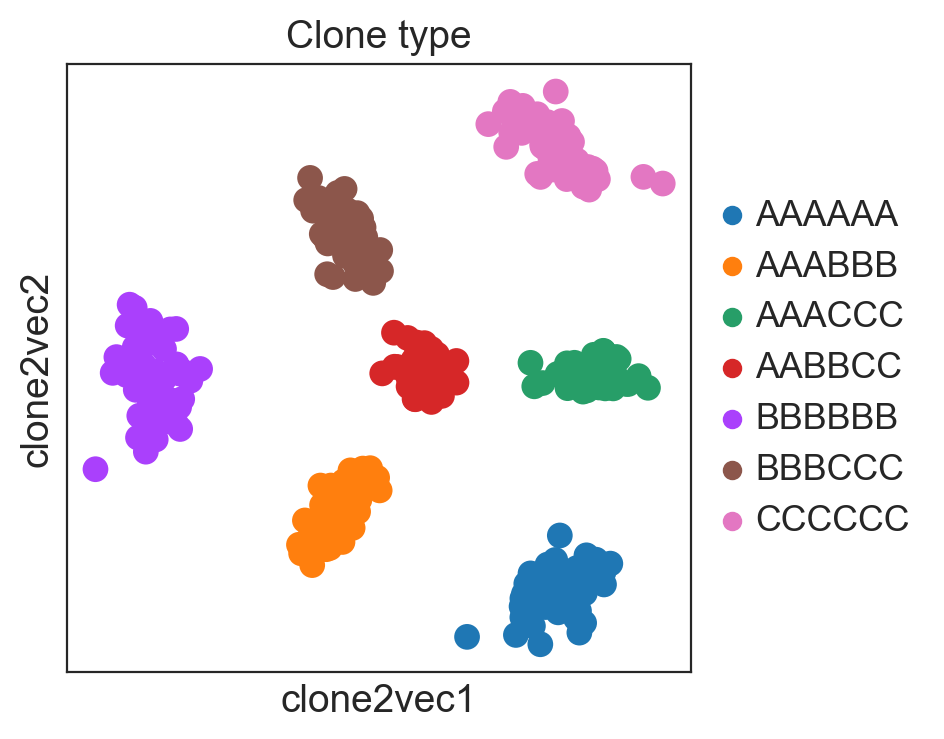

In [473]:
clones.obs["clone_type"] = [clones_ground_truth[clone] for clone in clones.obs_names]

sc.pl.embedding(
    clones,
    color="clone_type",
    basis="clone2vec",
    title="Clone type",
    save="clone2vec.pdf",
)

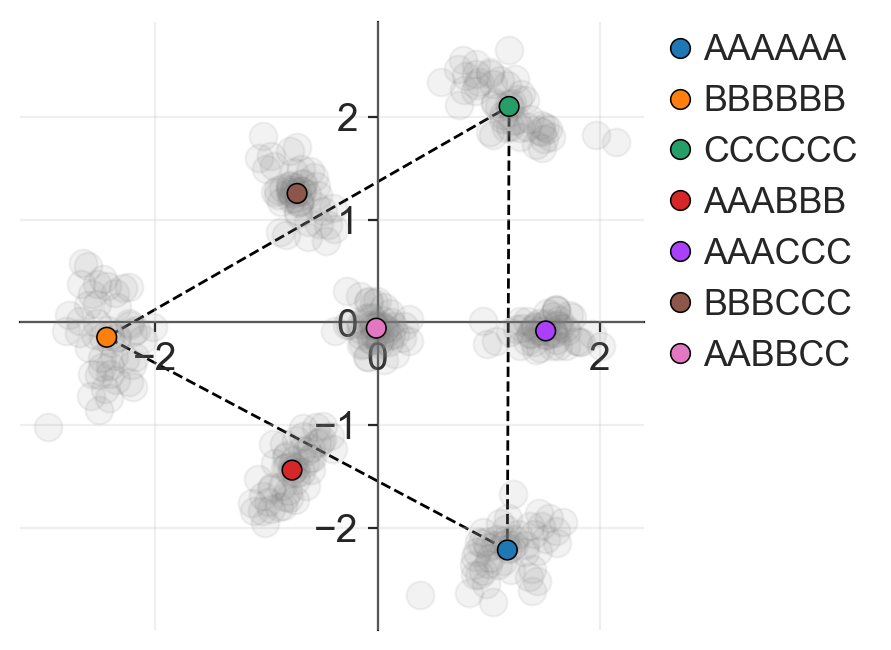

In [474]:
fig, ax = plt.subplots(figsize=(4, 4))

sns.scatterplot(
    x=clones.obsm["clone2vec"][:, 0],
    y=clones.obsm["clone2vec"][:, 1],
    ax=ax,
    edgecolor=None,
    color="grey",
    alpha=0.1,
    s=100,
)

centers_dict = {}
for clone_type in clone_types:
    centers_dict[clone_type] = clones[
        clones.obs.clone_type == clone_type
    ].obsm["clone2vec"].mean(axis=0)
centers = pd.DataFrame(centers_dict, index=["clone2vec1", "clone2vec2"]).T
centers["clone_type"] = centers.index

centers_triag = centers.loc[[
    "AAAAAA", "BBBBBB",
    "CCCCCC", "AAAAAA",
]]
ax.plot(
    centers_triag.clone2vec1,
    centers_triag.clone2vec2,
    zorder=-1,
    color="black",
    linewidth=1,
    linestyle="--",
)

sns.scatterplot(
    x=centers["clone2vec1"],
    y=centers["clone2vec2"],
    hue=centers["clone_type"],
    ax=ax,
    edgecolor="black",
    color="grey",
    alpha=1,
    s=50,
)

ax.spines["left"].set_position("zero")
ax.spines["left"].set_zorder(-1)
ax.spines["bottom"].set_position("zero")
ax.spines["bottom"].set_zorder(-1)
ax.spines["right"].set_color("none")
ax.spines["top"].set_color("none")

ax.set_xlabel("")
ax.set_ylabel("")

ax.grid(alpha=0.3)
ax.legend(loc=(1.02, 0.4), edgecolor="white")

plt.savefig("figures_geometry/geometry_coordinates.pdf", bbox_inches="tight")

/tmp/ipykernel_32351/2120456257.py:24: UserWarning: The palette list has more values (17) than needed (4), which may not be intended.
  sns.scatterplot(


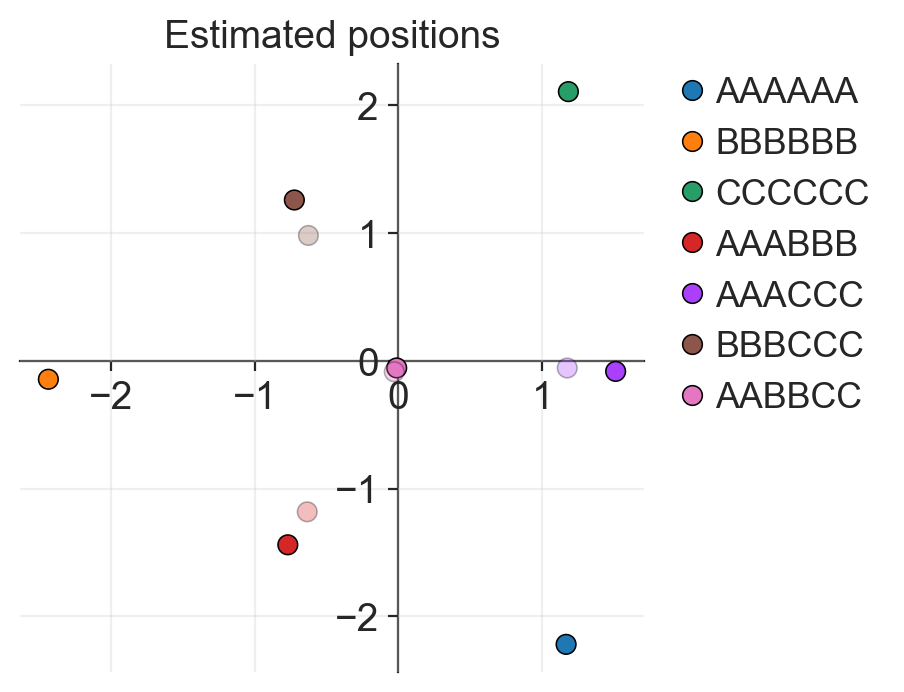

In [475]:
centers_estimated_dict = {
    "AAABBB": (centers_dict["AAAAAA"] + centers_dict["BBBBBB"]) / 2,
    "AAACCC": (centers_dict["AAAAAA"] + centers_dict["CCCCCC"]) / 2,
    "BBBCCC": (centers_dict["BBBBBB"] + centers_dict["CCCCCC"]) / 2,
    "AABBCC": (centers_dict["AAAAAA"] + centers_dict["BBBBBB"] + centers_dict["CCCCCC"]) / 3,
}

centers_estimated = pd.DataFrame(centers_estimated_dict, index=["clone2vec1", "clone2vec2"]).T
centers_estimated["clone_type"] = centers_estimated.index

fig, ax = plt.subplots(figsize=(4, 4))

sns.scatterplot(
    x=centers["clone2vec1"],
    y=centers["clone2vec2"],
    hue=centers["clone_type"],
    ax=ax,
    edgecolor="black",
    color="grey",
    alpha=1,
    s=50,
)

sns.scatterplot(
    x=centers_estimated["clone2vec1"],
    y=centers_estimated["clone2vec2"],
    hue=centers_estimated["clone_type"],
    ax=ax,
    edgecolor="black",
    color="grey",
    alpha=0.3,
    s=50,
    legend=False,
    palette=sns.color_palette()[3:],
)

ax.spines["left"].set_position("zero")
ax.spines["left"].set_zorder(-1)
ax.spines["bottom"].set_position("zero")
ax.spines["bottom"].set_zorder(-1)
ax.spines["right"].set_color("none")
ax.spines["top"].set_color("none")

ax.set_xlabel("")
ax.set_ylabel("")

ax.grid(alpha=0.3)
ax.legend(loc=(1.04, 0.4), edgecolor="white")
ax.set_title("Estimated positions")

plt.savefig("figures_geometry/geometry_predictions.pdf", bbox_inches="tight")

## Vector properties on real data

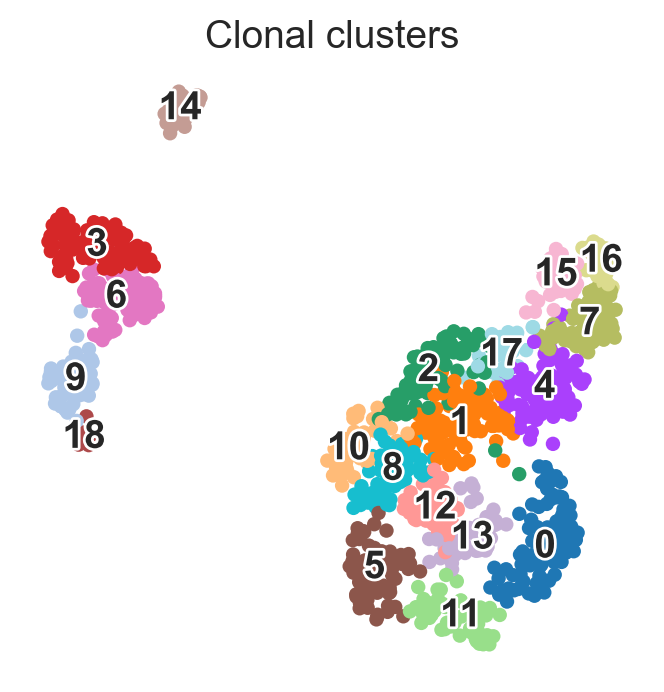

In [462]:
clones = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/E13_clonal_embedding.h5ad")

sc.pl.umap(clones, color="leiden_2", legend_loc="on data", frameon=False,
           na_in_legend=False, legend_fontoutline=2, title="Clonal clusters",
           save="paper_umap.pdf")

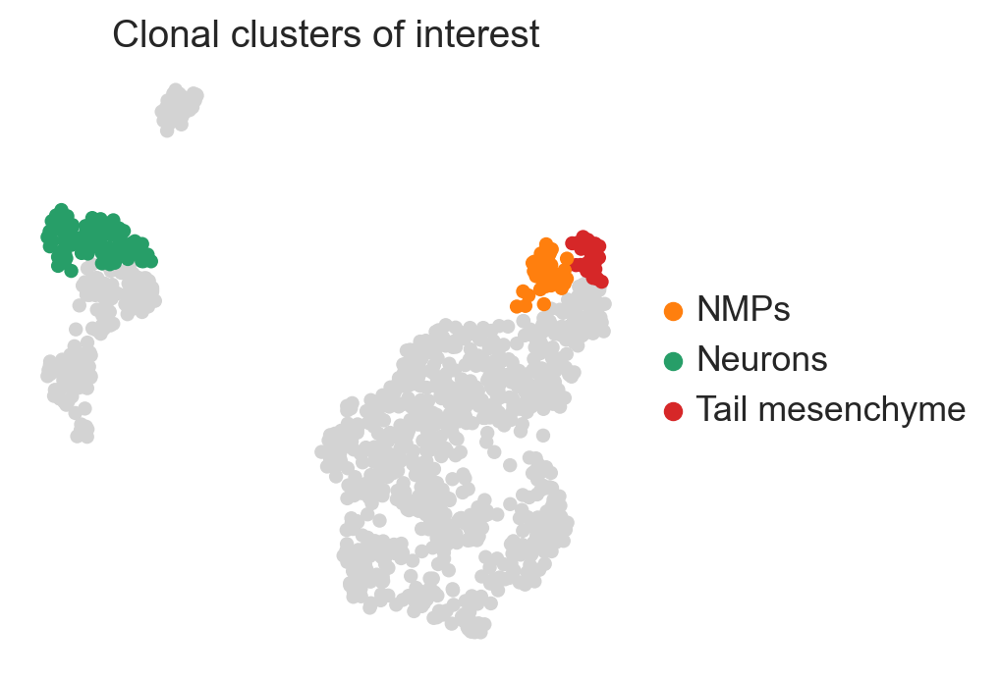

In [463]:
clones.obs["target_clones"] = [
    "Neurons" if i == "3" else
    "Tail mesenchyme" if i in ["16"] else
    "NMPs" if i == "15" else "NA"
    for i in clones.obs.leiden_2
]
sc.pl.umap(clones, color="target_clones", groups=["Neurons", "Tail mesenchyme", "NMPs"], frameon=False,
           na_in_legend=False, legend_fontoutline=2, title="Clonal clusters of interest", save="paper_subclusters.pdf")

/home/sergey/miniconda3/envs/sc/lib/python3.10/site-packages/sklearn/utils/validation.py:727: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  warnings.warn(


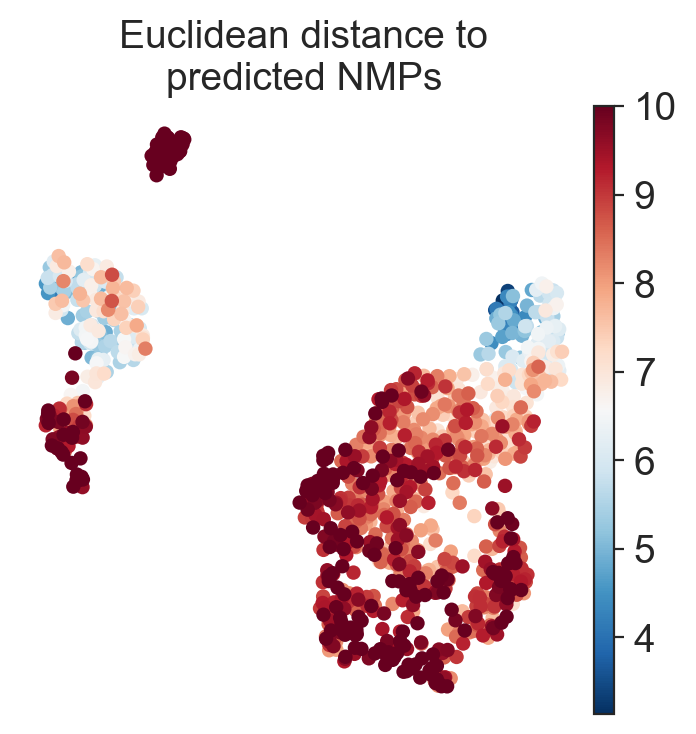

In [464]:
from sklearn.metrics.pairwise import euclidean_distances

tail_mes = clones[clones.obs.target_clones == "Tail mesenchyme"].obsm["word2vec"].mean(axis=0)
neurons = clones[clones.obs.target_clones == "Neurons"].obsm["word2vec"].mean(axis=0)

NMPs_simulated = (neurons + tail_mes) / 2
clones.obs["distance"] = euclidean_distances(clones.obsm["word2vec"], np.matrix(NMPs_simulated)).T[0]

sc.pl.umap(clones, color="distance", title="Euclidean distance to\npredicted NMPs", cmap="RdBu_r",
           vmax=10, frameon=False, save="distance_to_NMPs.pdf")

/tmp/ipykernel_32351/1557913622.py:15: FutureWarning: The default value of numeric_only in DataFrameGroupBy.median is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  order=clones.obs.groupby("leiden_2").median()[
/tmp/ipykernel_32351/1557913622.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(
/tmp/ipykernel_32351/1557913622.py:25: FutureWarning: The default value of numeric_only in DataFrameGroupBy.median is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  order=clones.obs.groupby("leiden_2").median()[


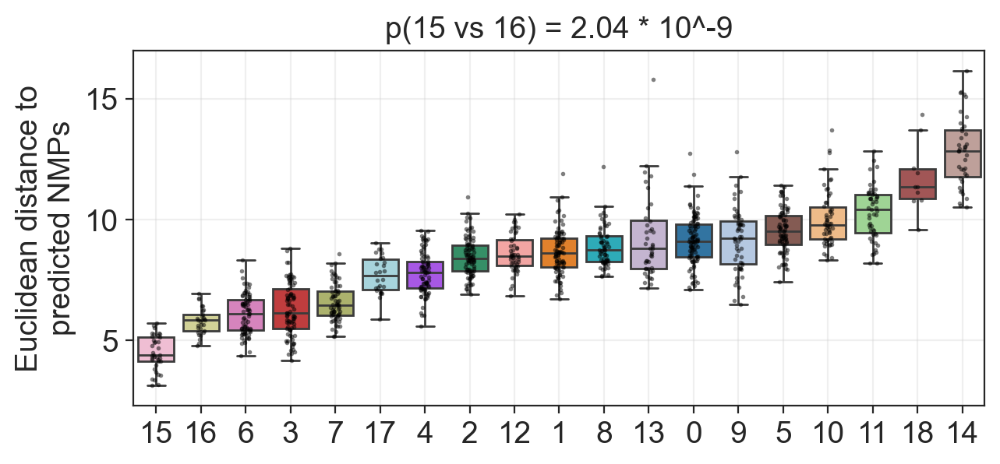

In [465]:
from scipy.stats import mannwhitneyu

fig, ax = plt.subplots(figsize=(7, 3))

sns.boxplot(
    x="leiden_2",
    y="distance",
    data=clones.obs,
    showfliers=False,
    ax=ax,
    palette=dict(zip(
        clones.obs.leiden_2.cat.categories,
        clones.uns["leiden_2_colors"]
    )),
    order=clones.obs.groupby("leiden_2").median()[
        "distance"
    ].sort_values().index,
)

sns.stripplot(
    x="leiden_2",
    y="distance",
    data=clones.obs,
    color="k",
    order=clones.obs.groupby("leiden_2").median()[
        "distance"
    ].sort_values().index,
    s=2,
    alpha=0.5,
)

ax.set_xlabel("")
ax.set_ylabel("Euclidean distance to\npredicted NMPs")
ax.grid(alpha=0.3)

p = mannwhitneyu(
    clones[clones.obs.leiden_2 == "15"].obs.distance,
    clones[clones.obs.leiden_2 == "16"].obs.distance,
).pvalue

p10 = 1 - int(np.log10(p))
p_int = np.round(p * 10**p10, 2)
ax.set_title(f"p(15 vs 16) = {p_int} * 10^-{p10}")

ax.set_ylim(None, 17)

plt.savefig("figures_geometry/distance_to_NMPs.pdf")